In [27]:
from torchvision.datasets.folder import ImageFolder
from torchvision import transforms
from torch.utils.data import DataLoader
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import numpy as np

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def random_cutout(imgs, min_cut=15,max_cut=45):
    n, c, h, w = imgs.shape
    w1 = np.random.randint(min_cut, max_cut, n)
    h1 = np.random.randint(min_cut, max_cut, n)
    
    w2 = np.random.randint(min_cut, max_cut, n)
    h2 = np.random.randint(min_cut, max_cut, n)
    
    cutouts = torch.empty((n, c, h, w), dtype=imgs.dtype, device=imgs.device)
    for i, (img, w11, h11, w22, h22) in enumerate(zip(imgs, w1, h1, w2, h2)):
        cut_img = img.clone()
        cut_img[:, h11:h11 + h11, w11:w11 + w11] = 0
        cut_img[:, h22:h22 + h11, w22:w22 + w22] = 0
        cutouts[i] = cut_img
    return cutouts


def plot_img(x):
    img_grid = make_grid(x[:16])
    plt.figure(figsize=(20,15))
    plt.imshow(img_grid.cpu().permute(1, 2, 0))
    plt.axis('off')
    plt.show()

In [28]:
from torchvision.datasets.folder import ImageFolder
from tqdm.notebook import tqdm
from statistics import mean

def get_faces_loader(path, **kwargs):
    process = transforms.Compose(
     # [transforms.Resize((480, 480)), transforms.CenterCrop((256, 256)),transforms.ToTensor()])
        [transforms.Resize((120, 120)), transforms.CenterCrop((64, 64)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    lengths = [12000, 1233]
    train_set, val_set = torch.utils.data.random_split(dataset, lengths)
    return DataLoader(train_set, **kwargs), DataLoader(val_set, **kwargs)

In [29]:
from torchvision.datasets.folder import ImageFolder
from tqdm.notebook import tqdm
from statistics import mean

def get_faces_loader(path, **kwargs):
    process = transforms.Compose(
     # [transforms.Resize((480, 480)), transforms.CenterCrop((256, 256)),transforms.ToTensor()])
        [transforms.Resize((120, 120)), transforms.CenterCrop((64, 64)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    lengths = [len(dataset)-1200, 1200]
    train_set, val_set = torch.utils.data.random_split(dataset, lengths)
    return DataLoader(train_set, **kwargs), DataLoader(val_set, **kwargs)

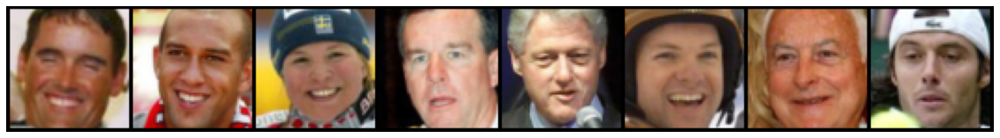

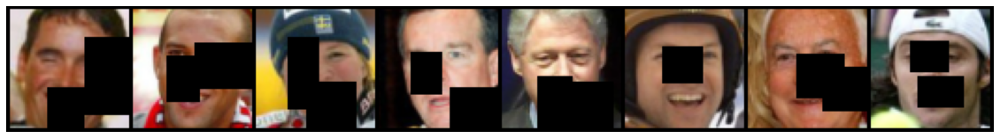

In [30]:
trainloader, testloader = get_faces_loader(path='./data/lfw', 
                                    batch_size=32, 
                                    shuffle=True, 
                                    num_workers=0)
x, _ = next(iter(trainloader))
x_co = random_cutout(x)
plot_img(x[:8])
plot_img(x_co[:8])

### Méthode pour ségmenter l'input

In [31]:
import impaintingLib as imp
classif = imp.loss.getTrainedModel()

#def simplify_segmentation(x):
#    x = x.argmax(1)
#    x[x==5] = 4
#    x[x==6] = 5
#    x[x==7] = 5
#    x[x==8] = 6
#    x[x==9] = 6
#    x[x==10] = 7
#    x[x==11] = 8
#    x[x==12] = 8
#    x[x>12] = 0
#    return (x/9).unsqueeze(1) + 0.1

def simplify_segmentation(x):
    x = x.argmax(1)
    return (x/20).unsqueeze(1) + 0.1

def get_segmentation(x, segmenter=classif, scale_factor=4, simplify=True):
    with torch.no_grad():
        x = torch.nn.functional.interpolate(x, scale_factor=scale_factor)
        x = transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))(x)
        y = classif(x)
        y = torch.nn.functional.avg_pool2d(y, scale_factor)
    if simplify: return simplify_segmentation(y)
    else: return y

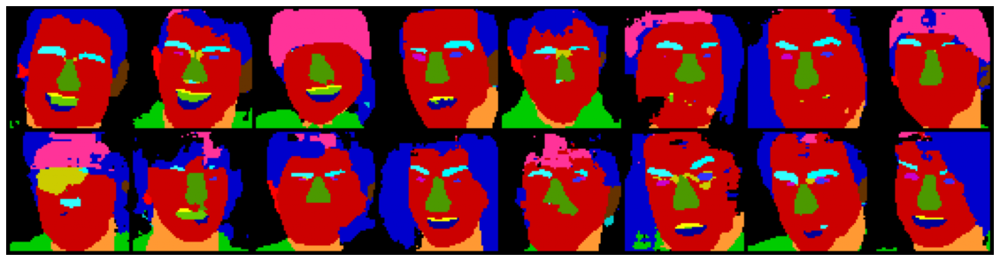

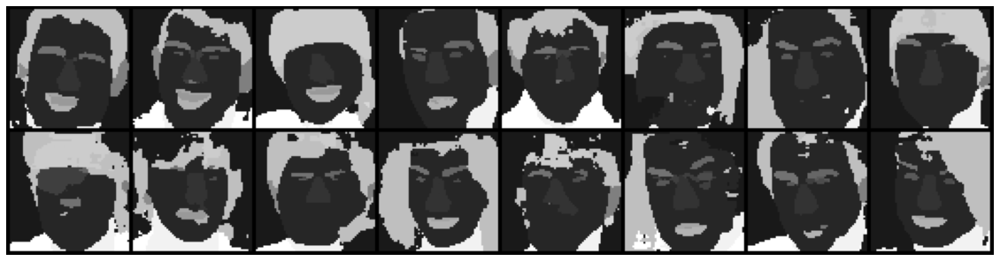

In [32]:
seg = get_segmentation(x.cuda(), simplify=False)
n,c,w,h = x.shape
classifDisplay = imp.loss.generate_label(seg,w).to(device)
plot_img(classifDisplay)
seg = get_segmentation(x.cuda(), simplify=True)
plot_img(seg)

### Code Training

In [33]:
import torchvision.models as models

def gram_matrix(input):
    a, b, c, d = input.size()   # a=batch size(=1)
                                # b=number of feature maps
                                # (c,d)=dimensions of a f. map (N=c*d)

    features = input.view(a * b, c * d) 
    G = torch.mm(features, features.t())  # compute the gram product
    # we 'normalize' the values of the gram matrix
    # by dividing by the number of element in each feature maps.
    return G.div(a * b * c * d)

class LossNetwork(torch.nn.Module):
    def __init__(self):
        super(LossNetwork, self).__init__()
        vgg_model = models.vgg16(pretrained=True).to(device).eval()
        self.vgg_layers = vgg_model.features
        self.layer_name_mapping = {
            '3': "relu1_2",
            '8': "relu2_2",
            '15': "relu3_3",
            '22': "relu4_3"
        }
    
    def forward(self, x):
        features = []
        for name, module in self.vgg_layers._modules.items():
            x = module(x)
            if name in self.layer_name_mapping:
                features.append(x)
        return features
    

loss_network = LossNetwork()

def perceptual_loss(x, y):
    mse = torch.nn.MSELoss()
    x_feats = loss_network(x)
    with torch.no_grad():
        y_feats = loss_network(y)
    #content loss:
    loss = mse(x_feats[2], y_feats[2].detach())
    #style loss:
    for feats, target_feats in zip(x_feats, y_feats):
        loss += mse(gram_matrix(feats), gram_matrix(target_feats.detach()))
    return loss

In [34]:
def train_inpainting_segmented(net, optimizer, loader, epochs=5, min_cut=15,max_cut=45, simplify_seg=True, show_images=True):
    criterion = torch.nn.L1Loss()
    for epoch in range(epochs):
        running_loss = []
        t = tqdm(loader)
        for x, _ in t:
            x = x.to(device)
            segmented = get_segmentation(x, simplify=simplify_seg)
            x_co = random_cutout(x, min_cut, max_cut)
            x_input = torch.cat((x_co, segmented),dim=1)
            outputs = net(x_input)
            loss = criterion(outputs, x) + perceptual_loss(outputs, x)
            running_loss.append(loss.item())
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t.set_description(f'training loss: {mean(running_loss)}')
        if show_images:
            plot_img(x[:8])
            plot_img(x_co[:8])
            if simplify_seg:
                plot_img(segmented[:8])
            else:
                classifDisplay = imp.loss.generate_label(segmented,w).to(device)
                plot_img(classifDisplay[:8])
            plot_img(torch.clip(outputs[:8], 0, 1))
            
def test_results_sample(net, testloader, simplify_seg=True, min_cut=15,max_cut=45, n=8):
    with torch.no_grad():
        x, _ = next(iter(testloader))
        x = x.to(device)
        segmented = get_segmentation(x, simplify=simplify_seg)
        x_co = random_cutout(x, min_cut, max_cut)
        x_input = torch.cat((x_co, segmented),dim=1)
        outputs = net(x_input)
        plot_img(x[:n])
        plot_img(x_co[:n])
        if simplify_seg:
            plot_img(segmented[:n])
        else:
            classifDisplay = imp.loss.generate_label(segmented,w).to(device)
            plot_img(classifDisplay[:n])
        plot_img(torch.clip(outputs[:n], 0, 1))

### Train avec noir et blanc

  0%|          | 0/377 [00:00<?, ?it/s]

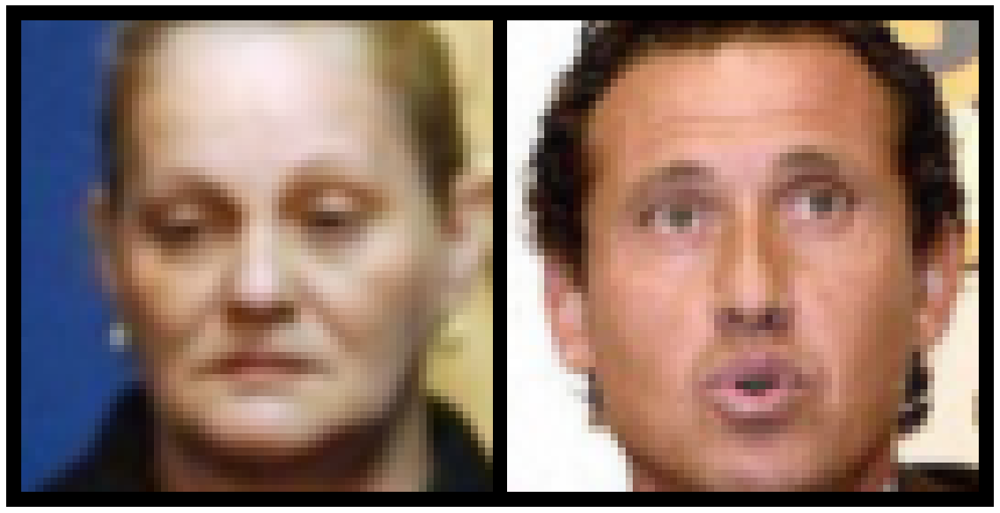

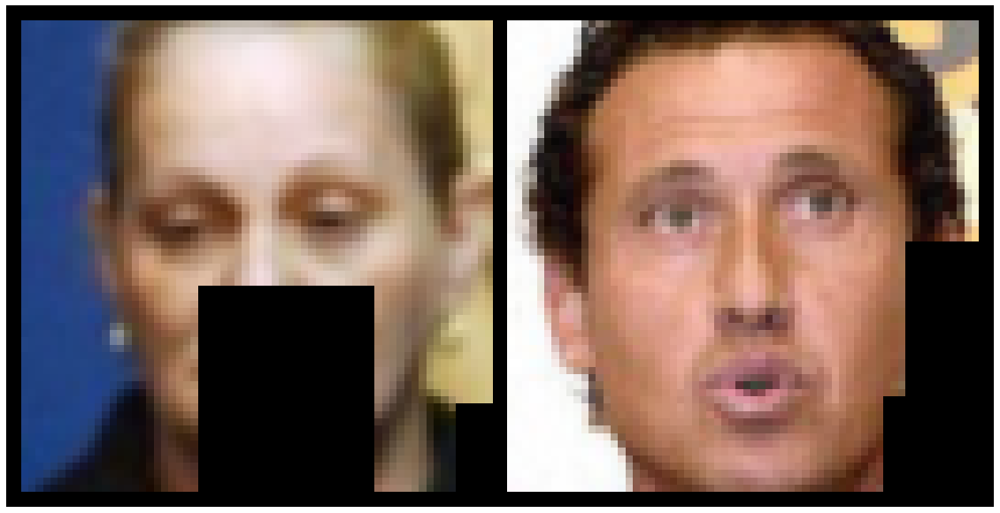

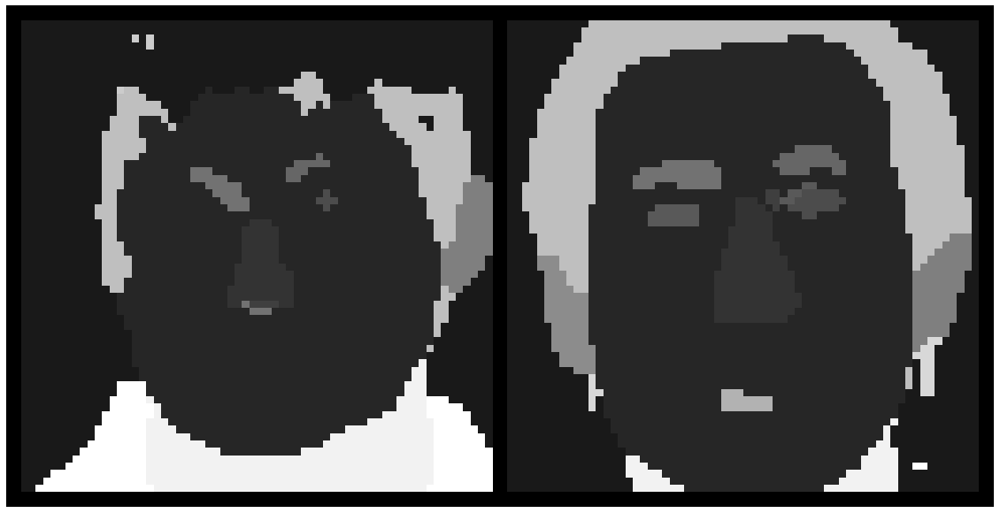

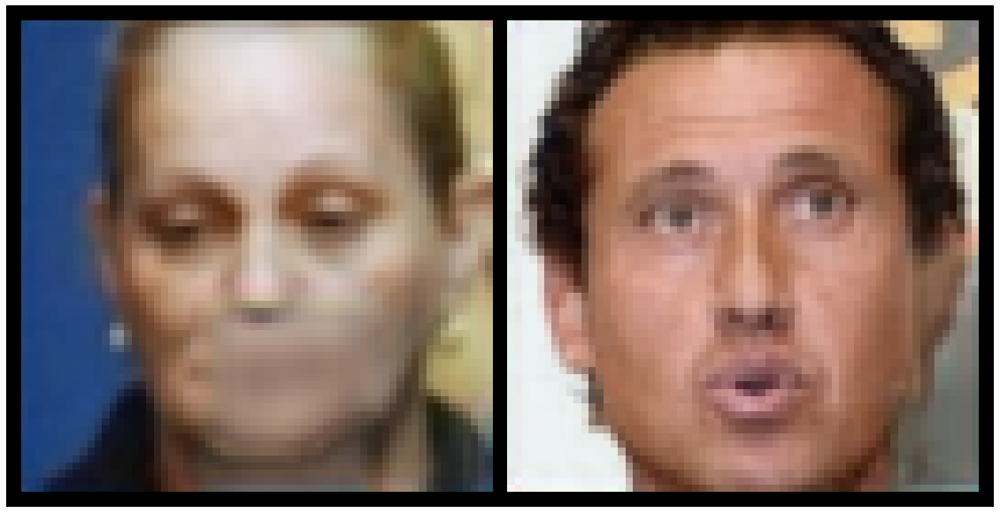

  0%|          | 0/377 [00:00<?, ?it/s]

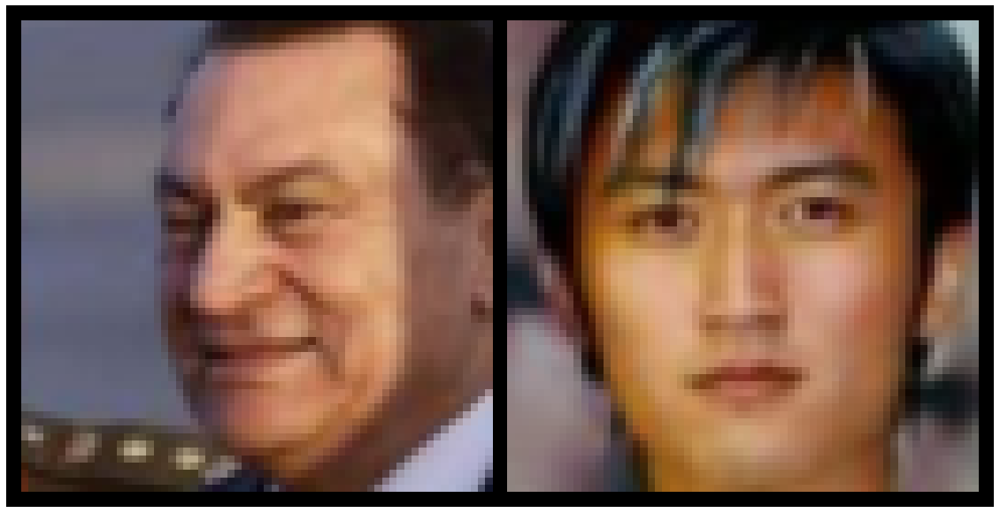

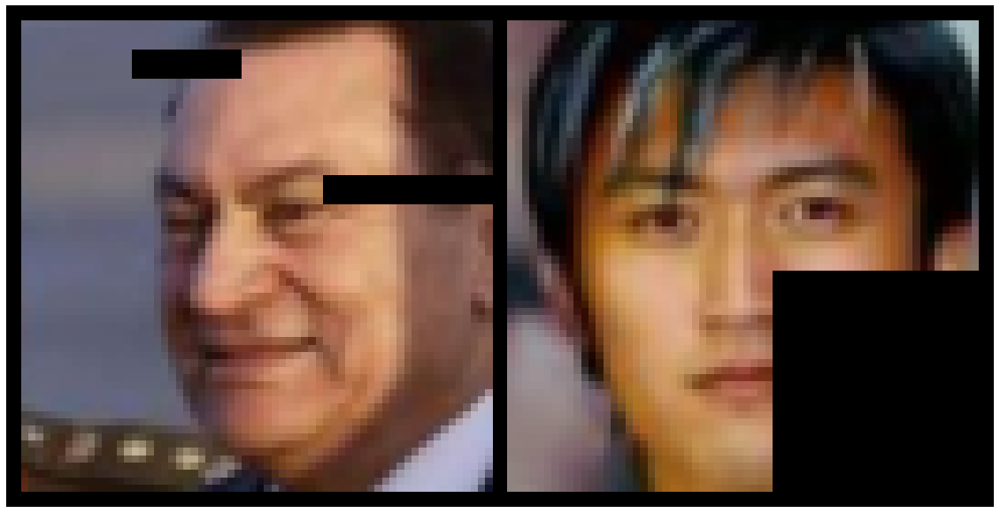

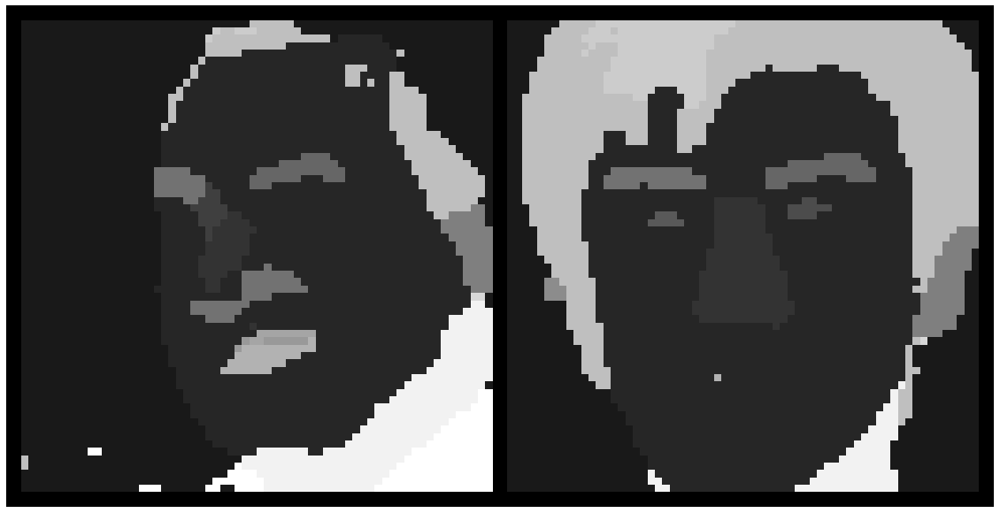

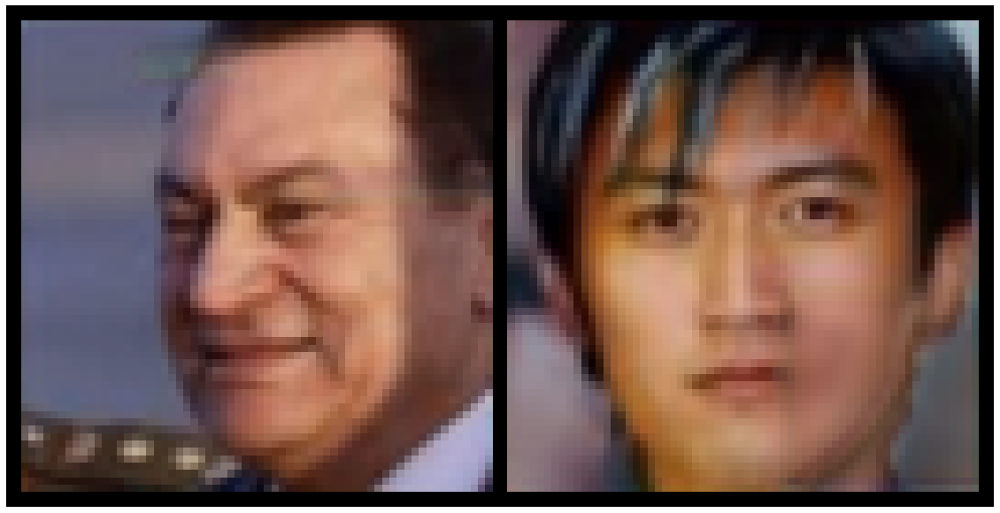

  0%|          | 0/377 [00:00<?, ?it/s]

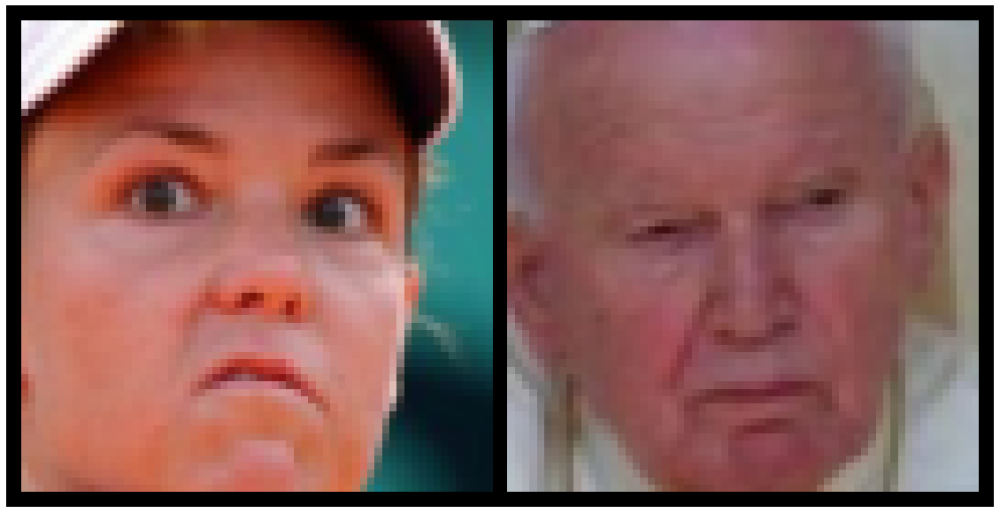

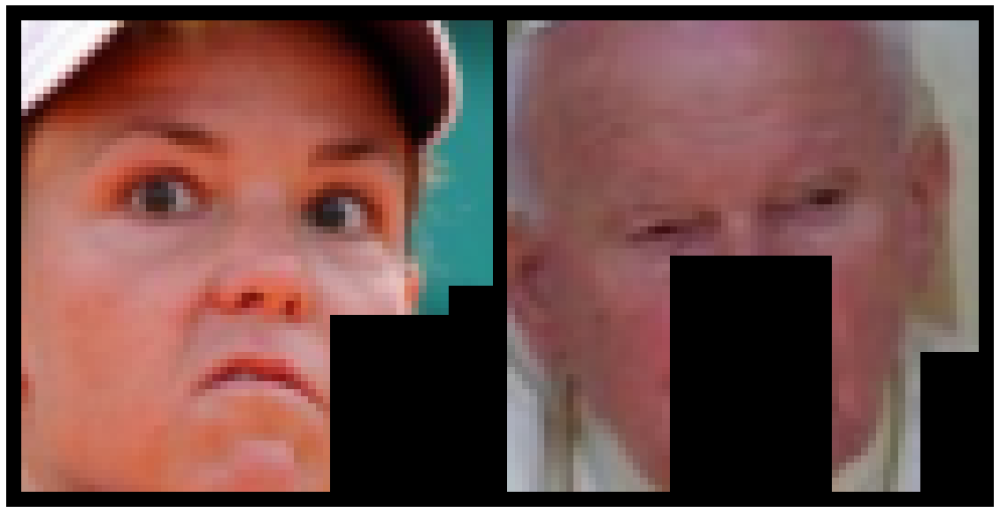

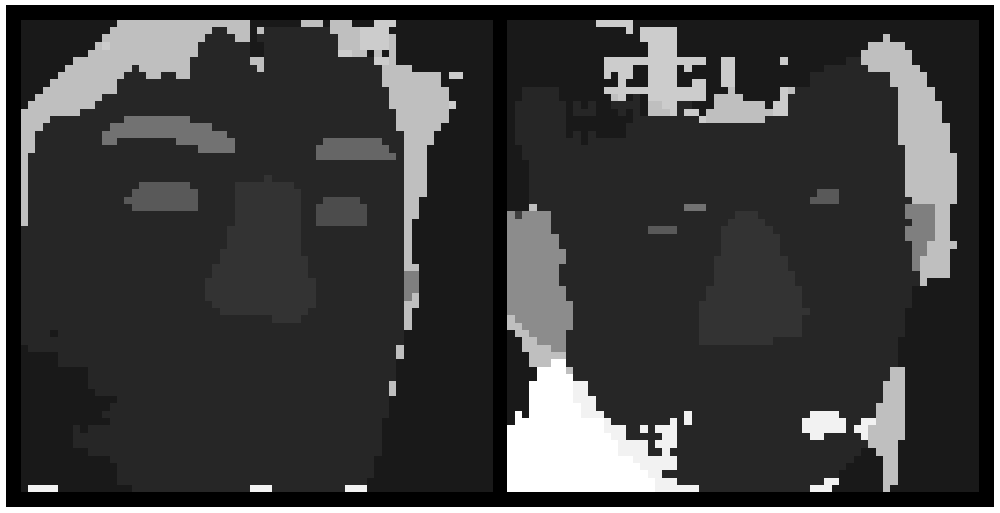

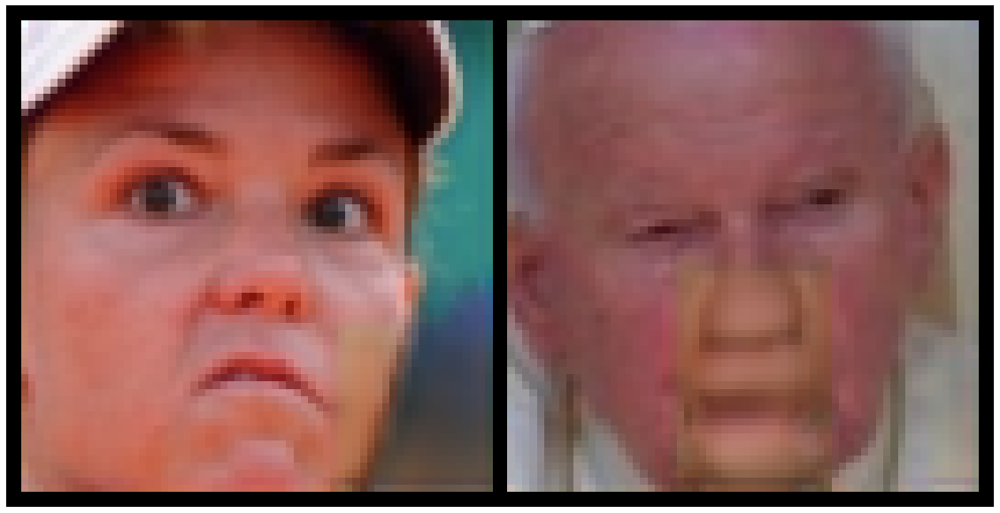

  0%|          | 0/377 [00:00<?, ?it/s]

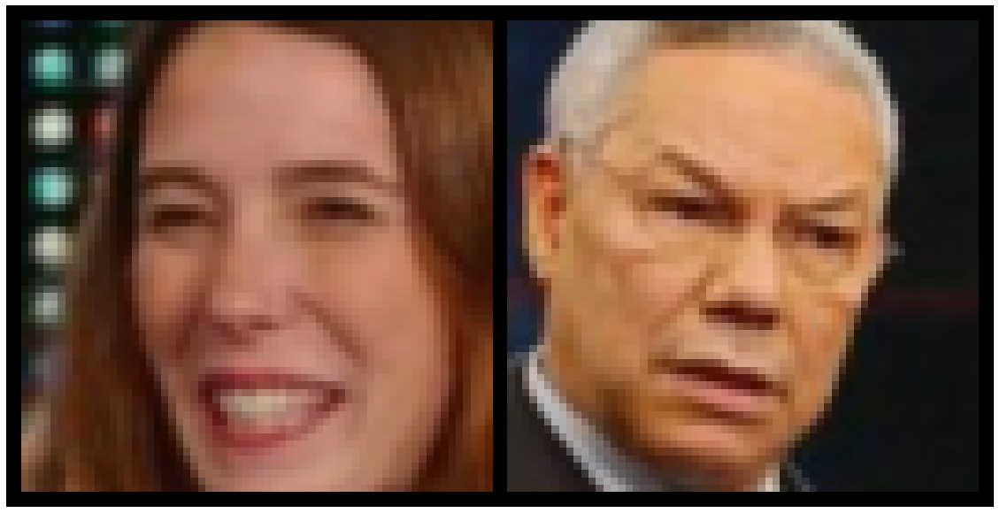

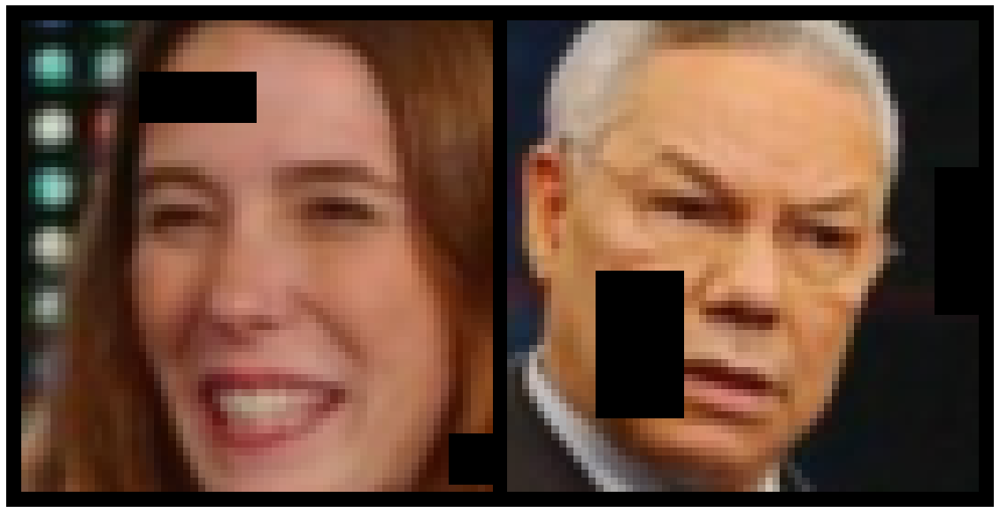

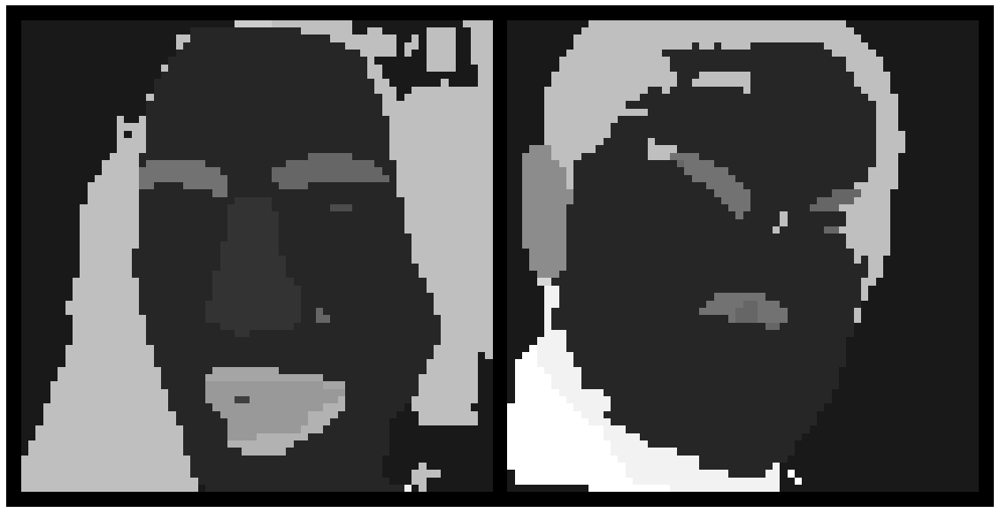

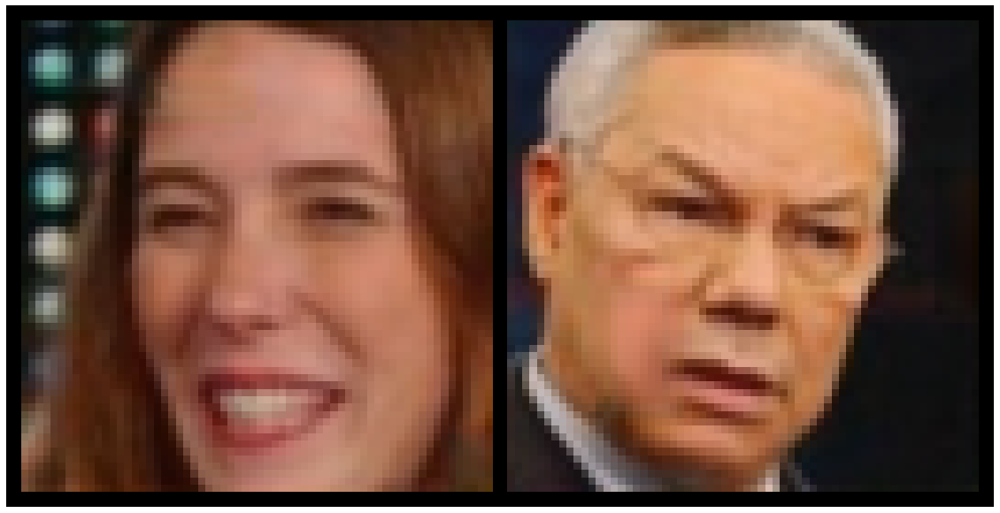

  0%|          | 0/377 [00:00<?, ?it/s]

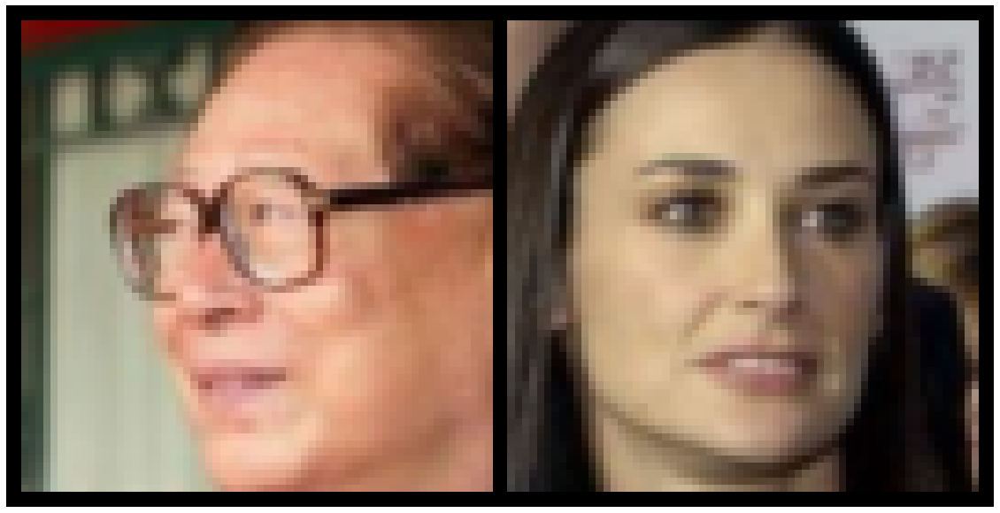

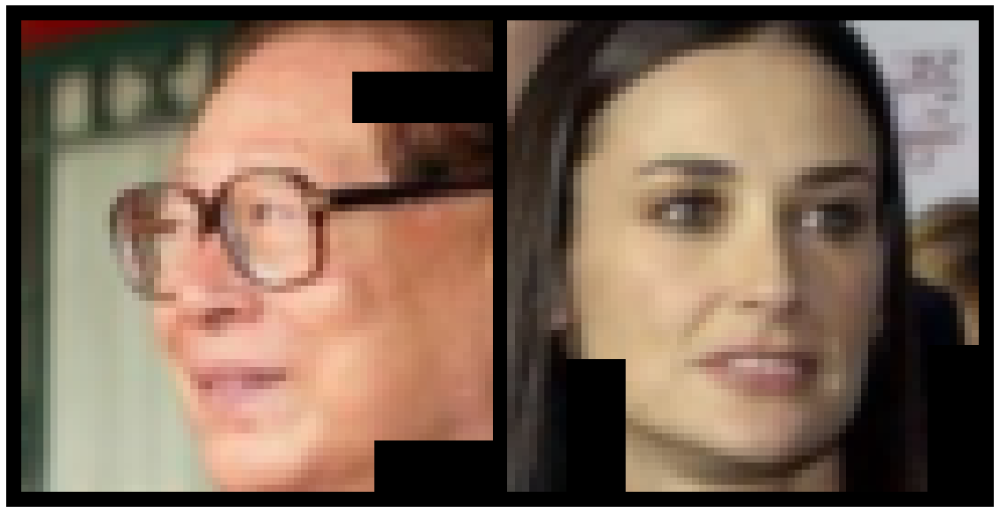

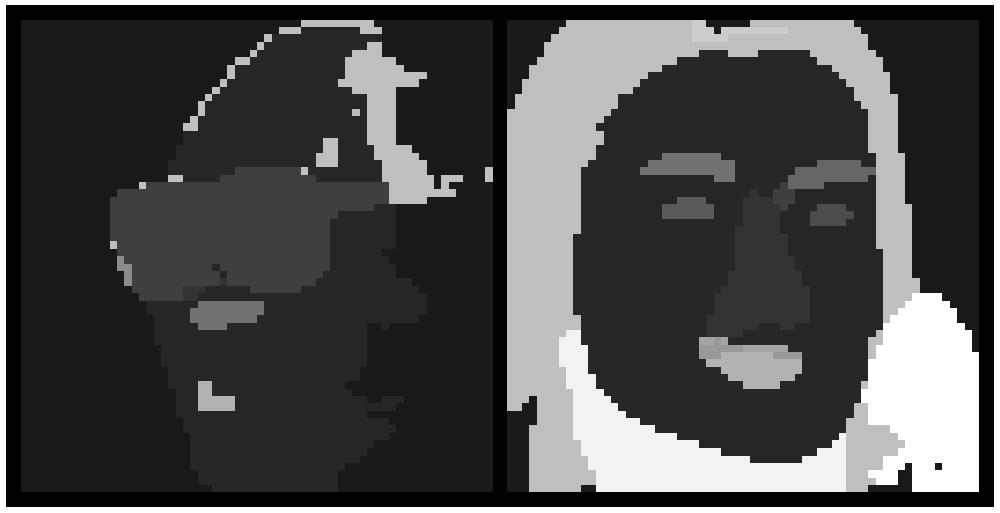

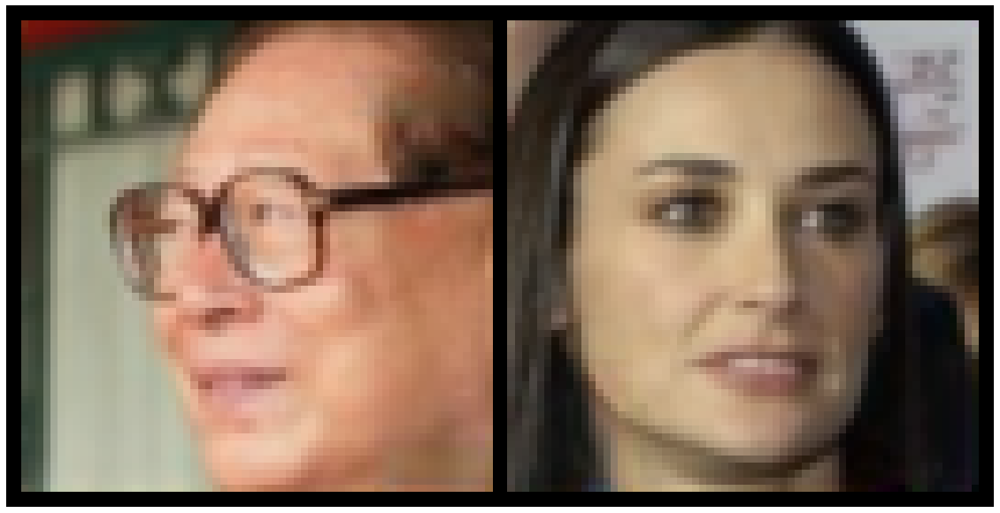

  0%|          | 0/377 [00:00<?, ?it/s]

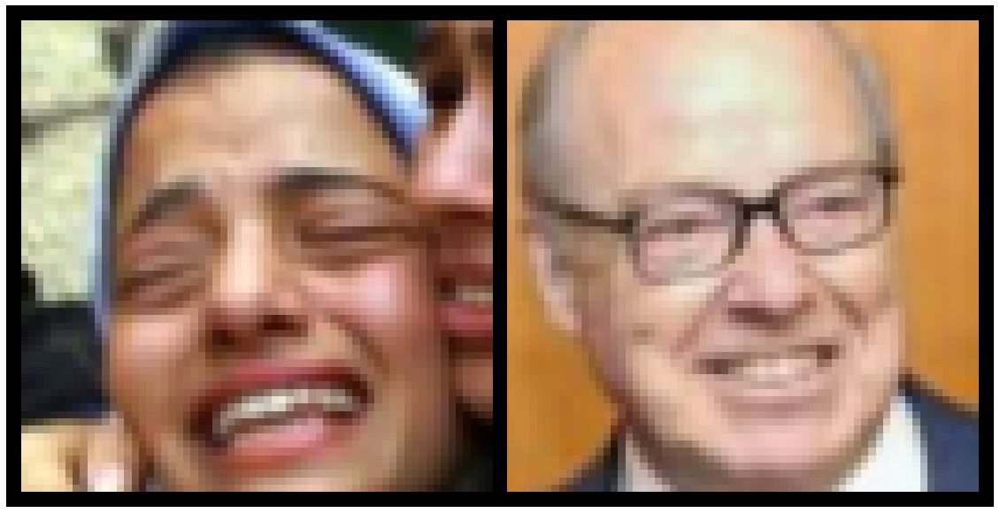

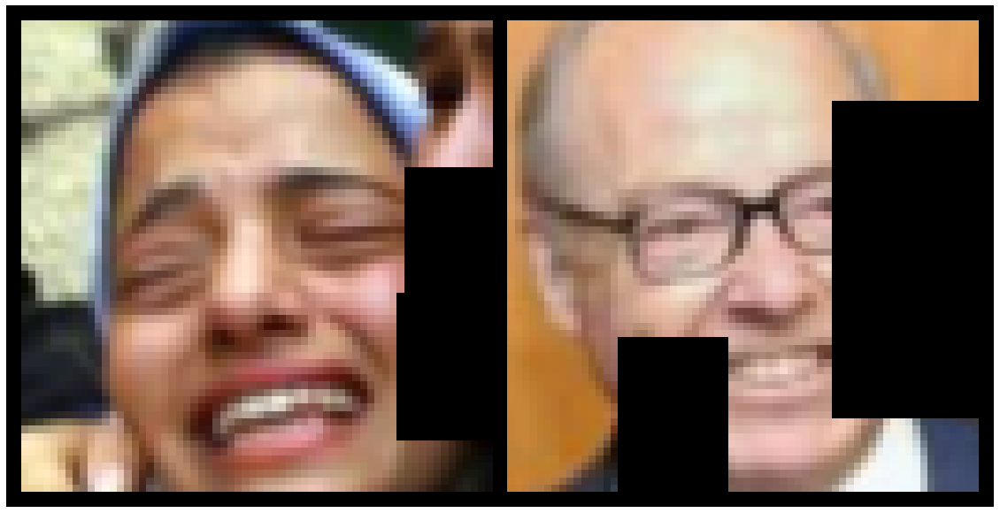

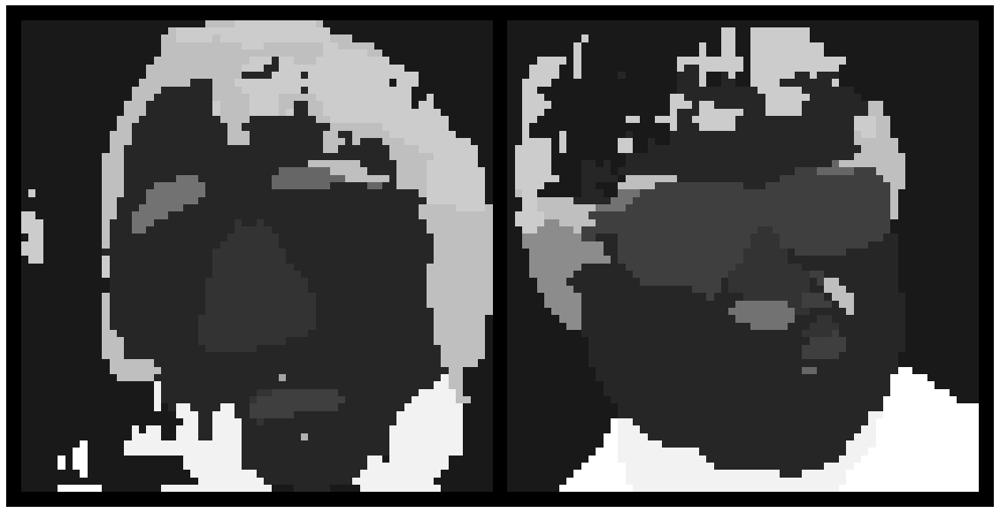

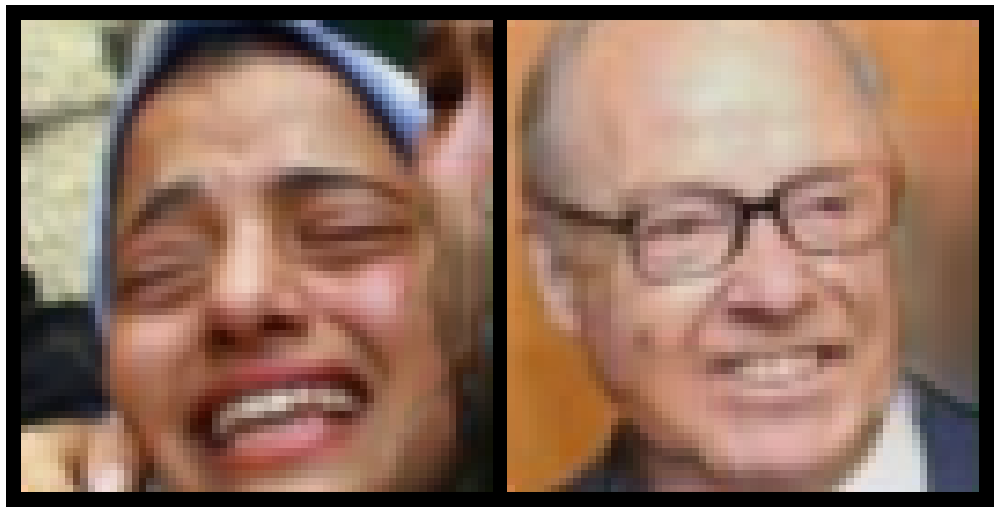

  0%|          | 0/377 [00:00<?, ?it/s]

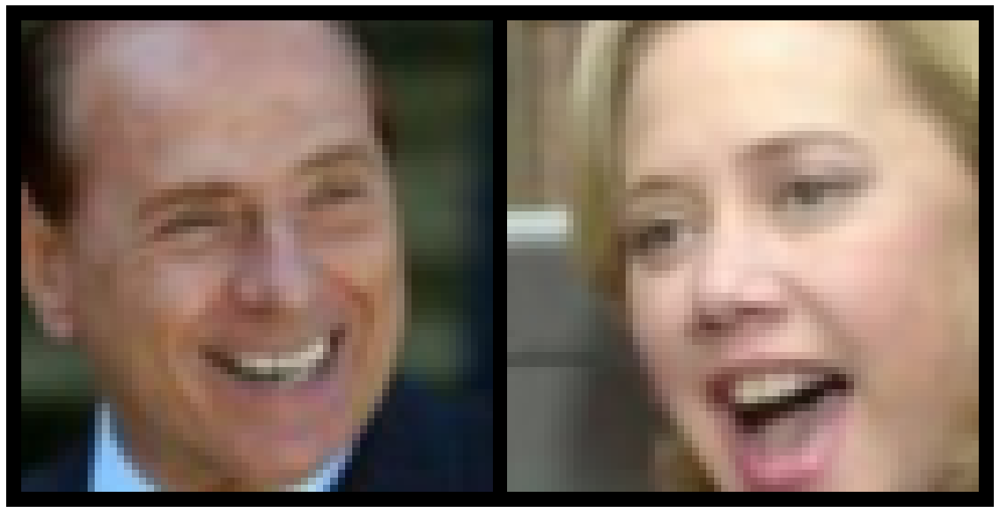

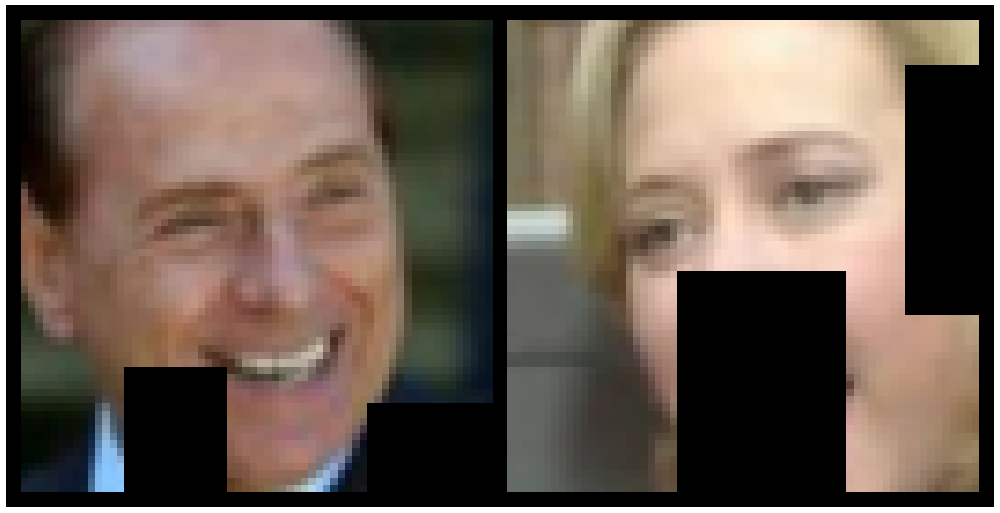

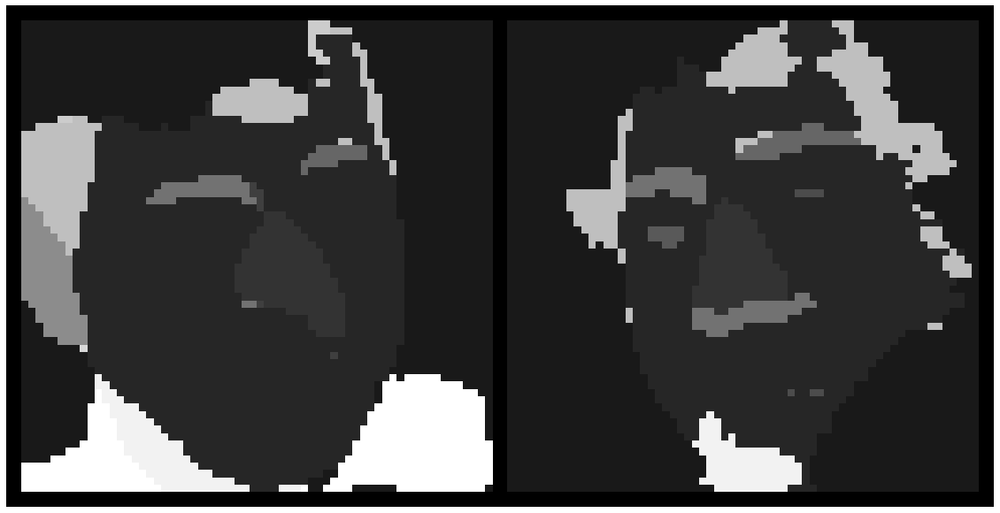

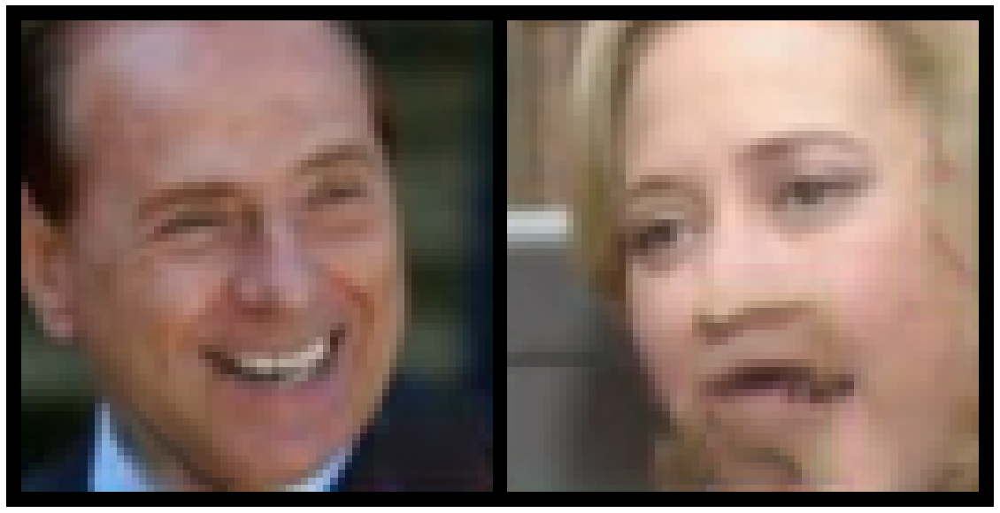

  0%|          | 0/377 [00:00<?, ?it/s]

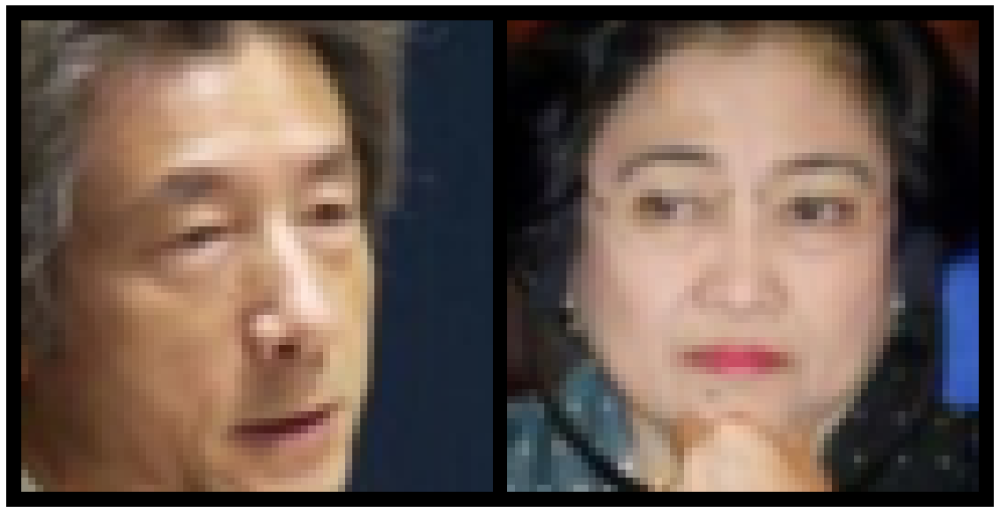

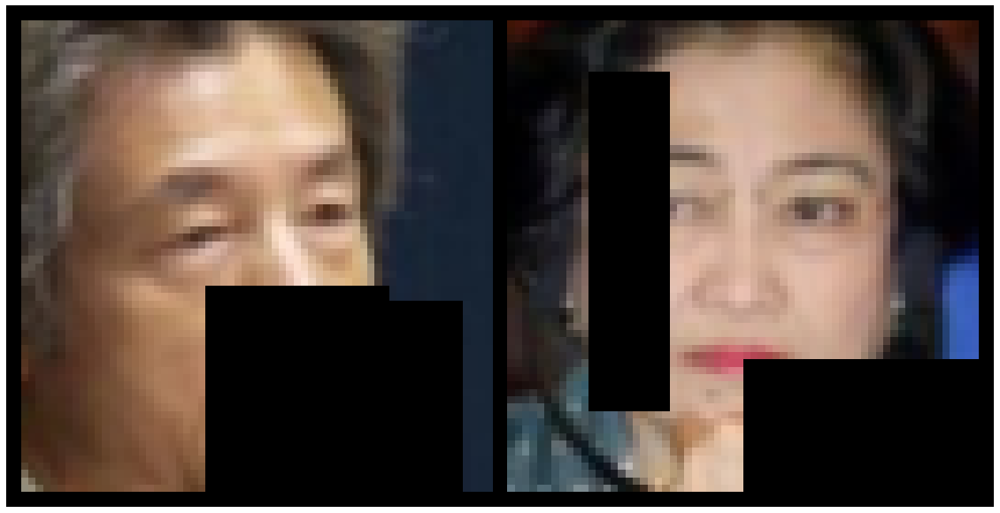

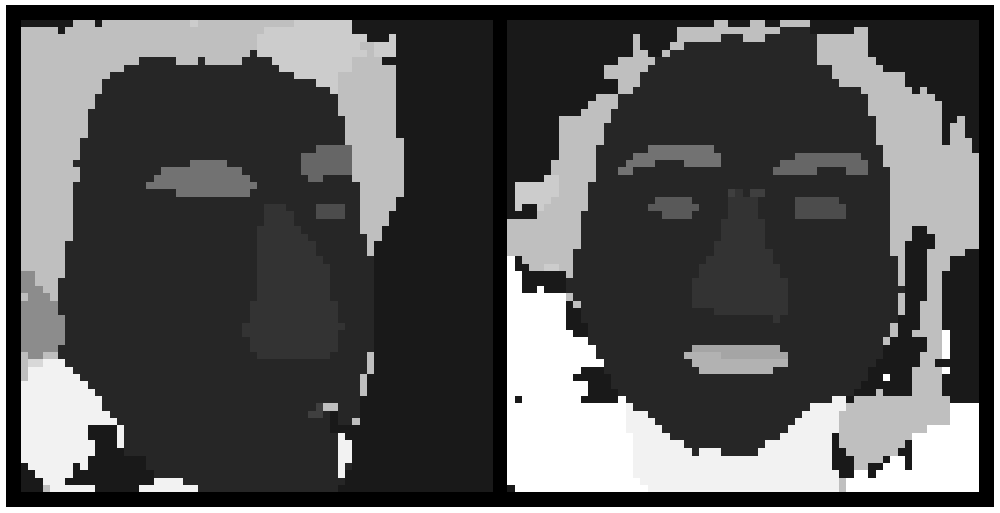

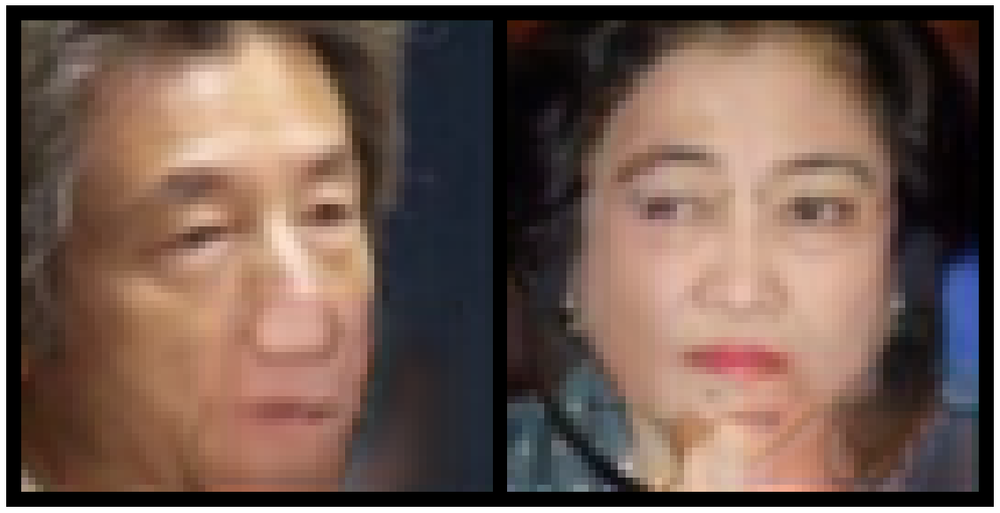

  0%|          | 0/377 [00:00<?, ?it/s]

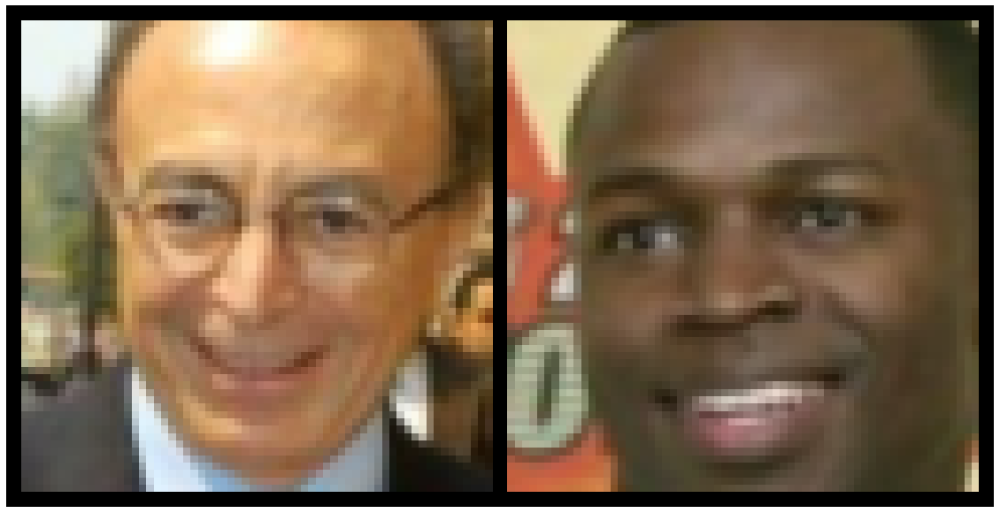

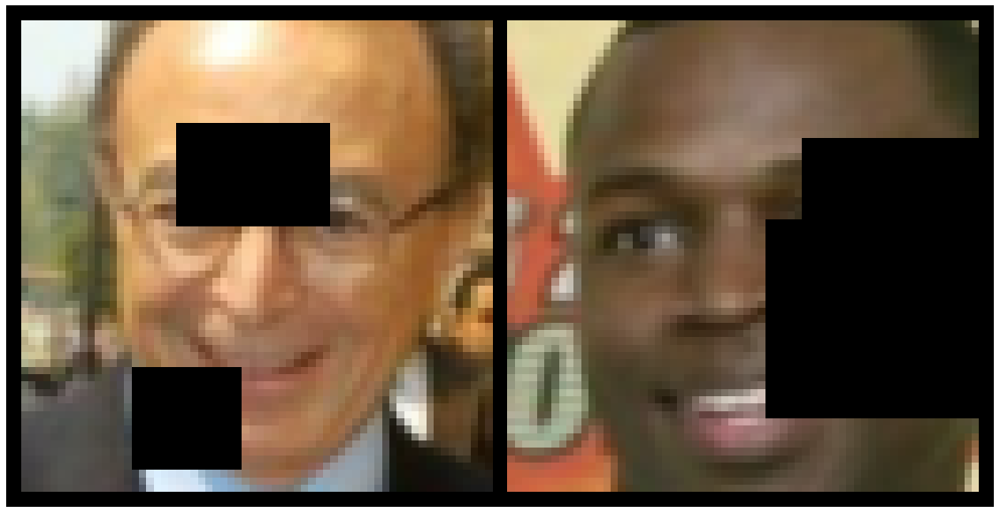

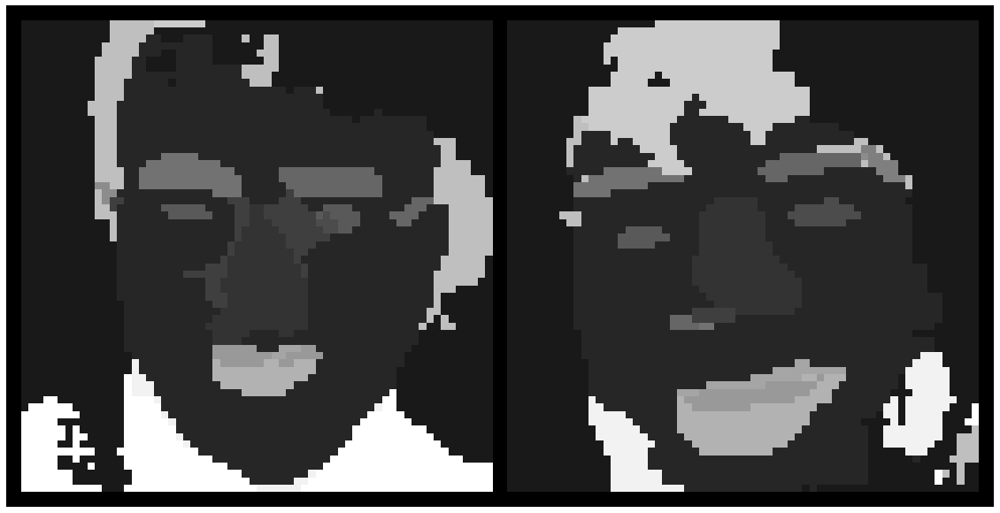

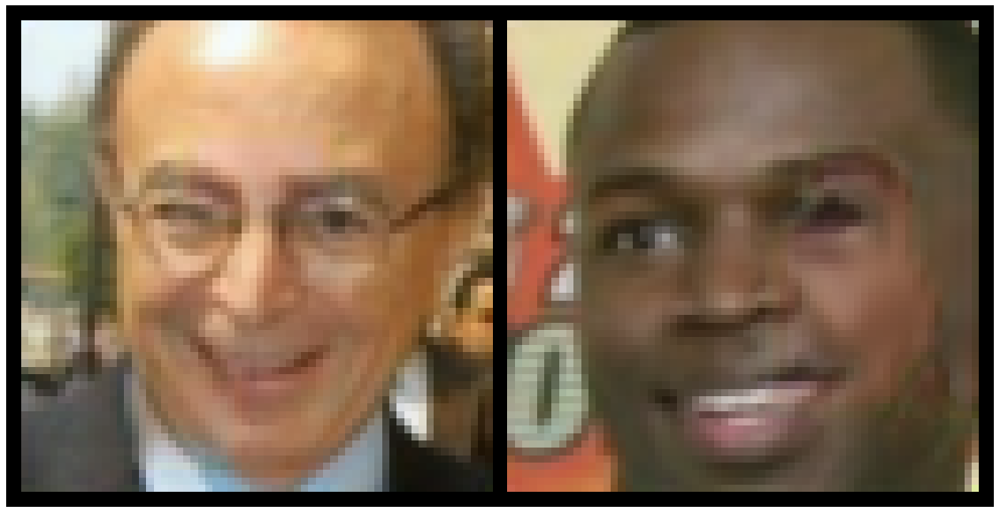

  0%|          | 0/377 [00:00<?, ?it/s]

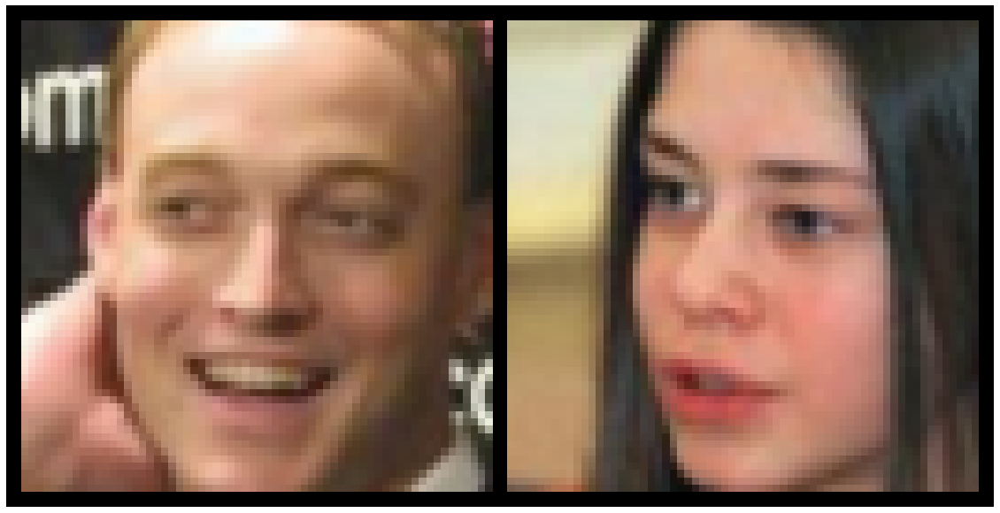

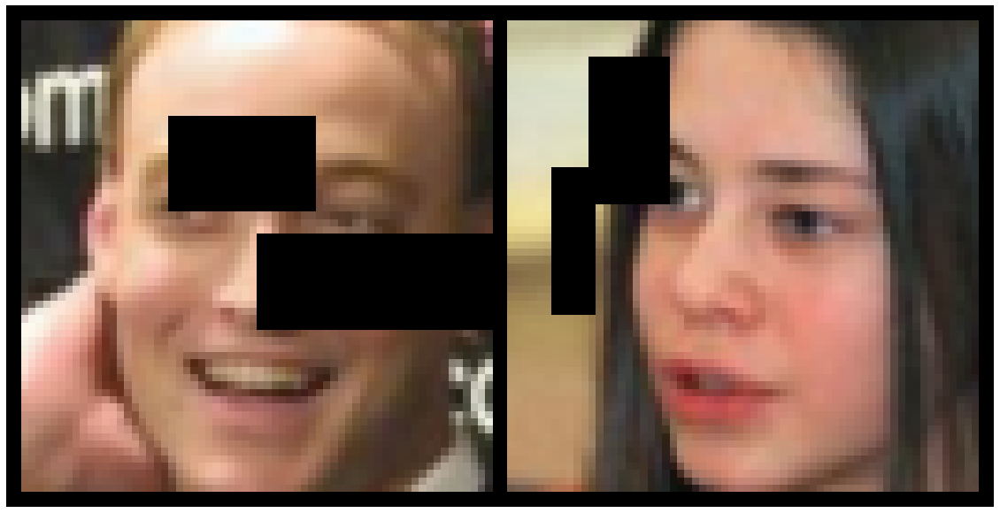

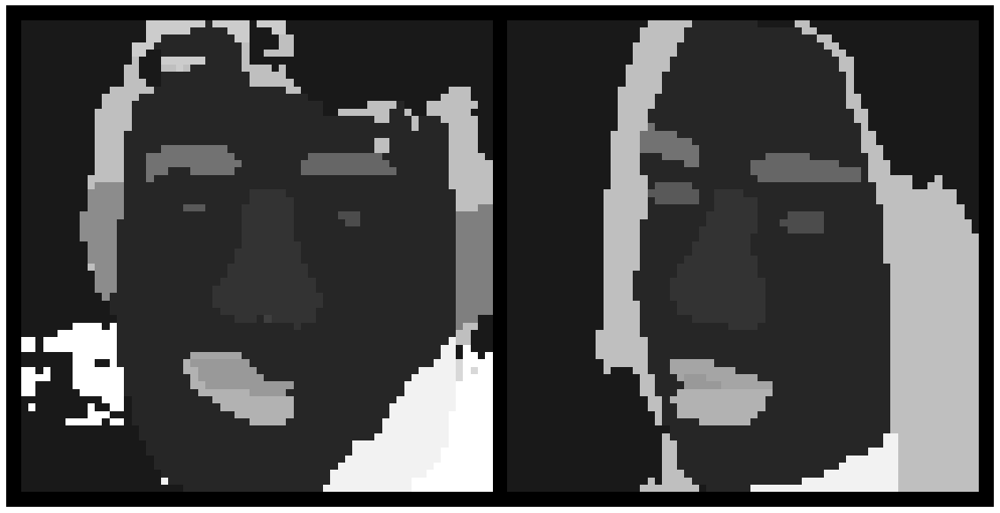

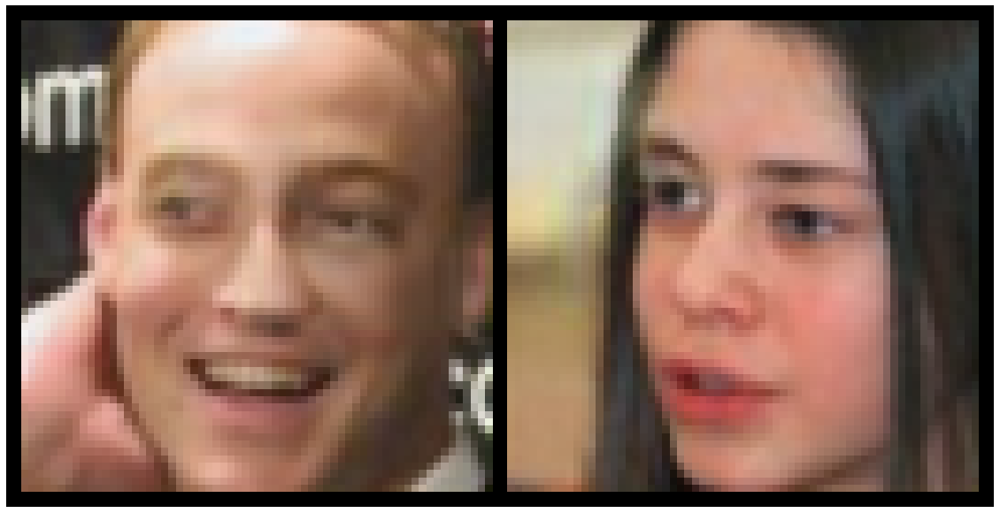

In [35]:
model = imp.model.UNet(4, netType="partial").to(device) 
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=0.001)
train_inpainting_segmented(model, optimizer, trainloader, simplify_seg=True, epochs=10, min_cut=4, max_cut=60)

### Test avec noir et blanc

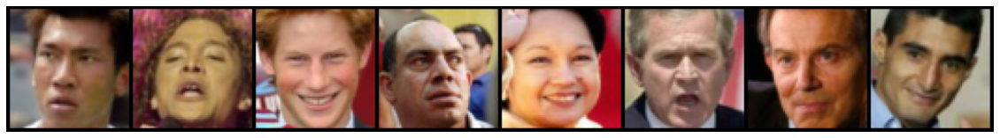

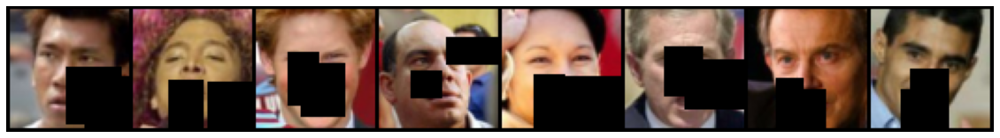

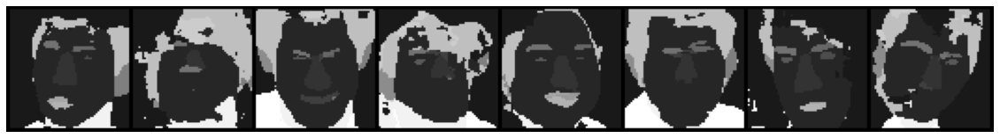

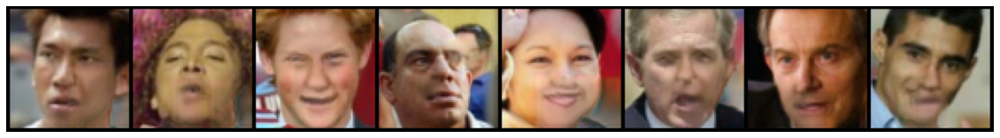

In [10]:
test_results_sample(model, testloader, simplify_seg=True, min_cut=15,max_cut=45)

In [11]:
def get_faces_loader(path, **kwargs):
    process = transforms.Compose(
     # [transforms.Resize((480, 480)), transforms.CenterCrop((256, 256)),transforms.ToTensor()])
        [transforms.Resize((240, 240)), transforms.CenterCrop((128, 128)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    lengths = [12000, 1233]
    train_set, val_set = torch.utils.data.random_split(dataset, lengths)
    return DataLoader(train_set, **kwargs), DataLoader(val_set, **kwargs)

In [12]:
trainloader, testloader = get_faces_loader(path='../test/data/lfw', 
                                    batch_size=16, 
                                    shuffle=True, 
                                    num_workers=0)

In [26]:
def train_inpainting_segmented(net, optimizer, loader, epochs=5, min_cut=15,max_cut=45, simplify_seg=True, show_images=True):
    criterion = torch.nn.L1Loss()
    for epoch in range(epochs):
        running_loss = []
        t = tqdm(loader)
        for x, _ in t:
            x = x.to(device)
            segmented = get_segmentation(x, simplify=simplify_seg, scale_factor=2)
            x_co = random_cutout(x, min_cut, max_cut)
            x_input = torch.cat((x_co, segmented),dim=1)
            outputs = net(x_input)
            loss = criterion(outputs, x) + perceptual_loss(outputs, x)
            running_loss.append(loss.item())
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t.set_description(f'training loss: {mean(running_loss)}')
        if show_images:
            plot_img(x[:8])
            plot_img(x_co[:8])
            if simplify_seg:
                plot_img(segmented[:8])
            #else:
            #    classifDisplay = imp.loss.generate_label(segmented,w).to(device)
            #    plot_img(classifDisplay[:8])
            plot_img(torch.clip(outputs[:8], 0, 1))
            
def test_results_sample(net, testloader, simplify_seg=True, min_cut=15,max_cut=45, n=8):
    with torch.no_grad():
        x, _ = next(iter(testloader))
        x = x.to(device)
        
        segmented = get_segmentation(x, simplify=simplify_seg)
        
        x_co = random_cutout(x, min_cut, max_cut)
        x_input = torch.cat((x_co, segmented),dim=1)
        outputs = net(x_input)
        plot_img(x[:n])
        plot_img(x_co[:n])
        if simplify_seg:
            plot_img(segmented[:n])
        #else:
        #    classifDisplay = imp.loss.generate_label(segmented,w).to(device)
        #    plot_img(classifDisplay[:8])
        plot_img(torch.clip(outputs[:n], 0, 1))

  0%|          | 0/750 [00:00<?, ?it/s]

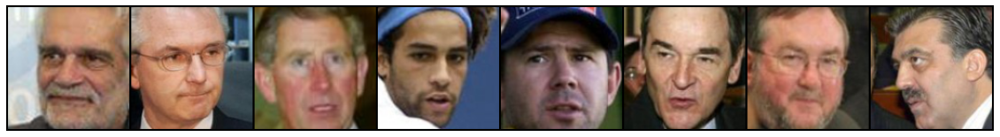

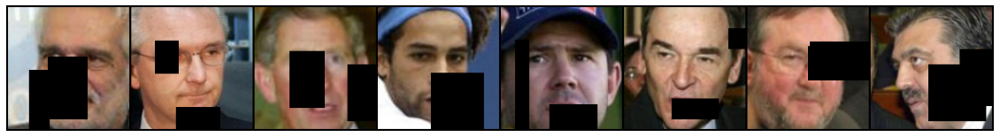

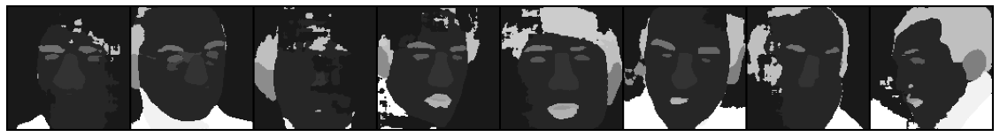

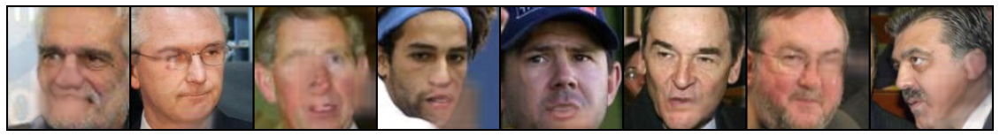

  0%|          | 0/750 [00:00<?, ?it/s]

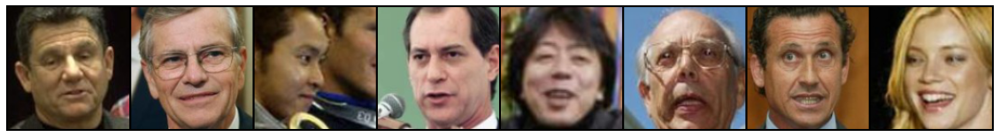

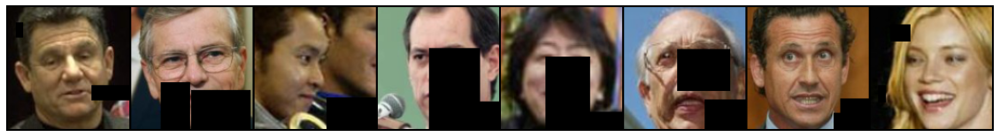

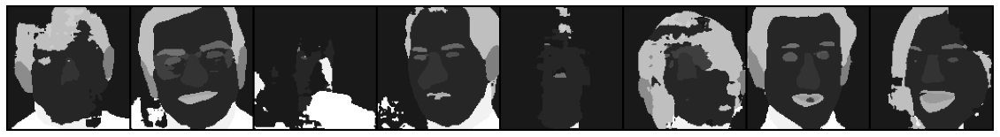

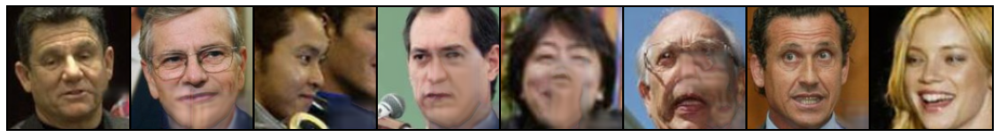

  0%|          | 0/750 [00:00<?, ?it/s]

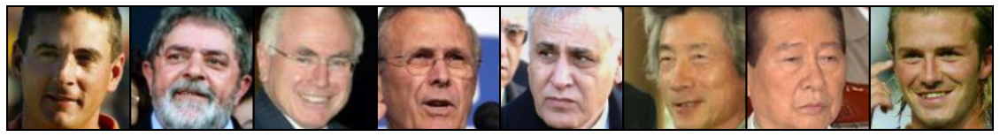

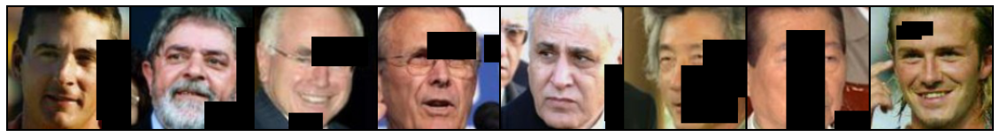

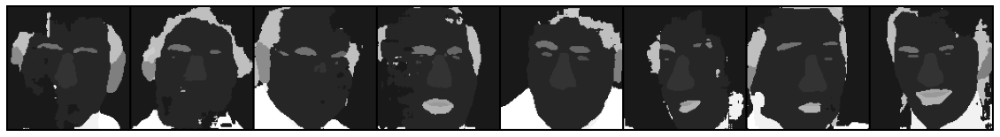

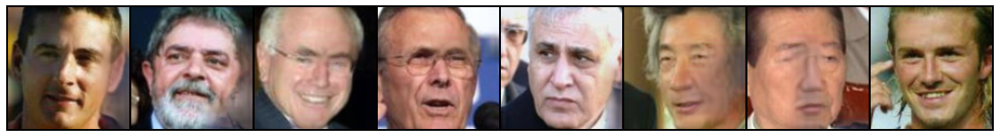

  0%|          | 0/750 [00:00<?, ?it/s]

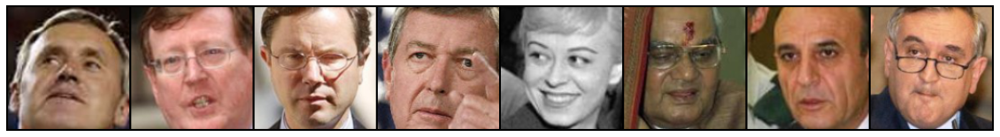

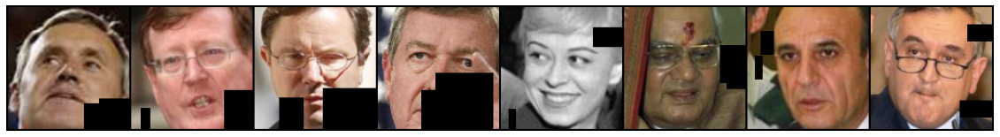

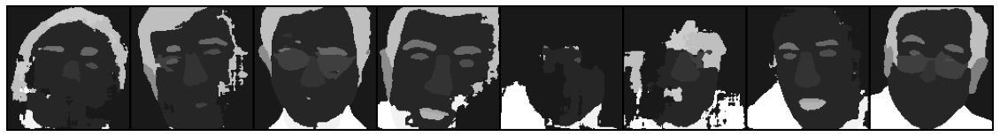

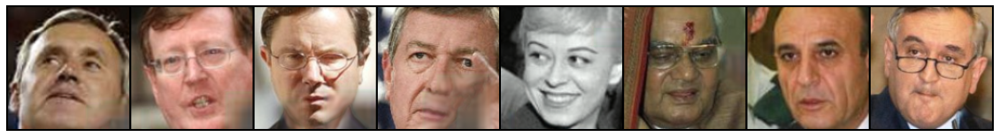

  0%|          | 0/750 [00:00<?, ?it/s]

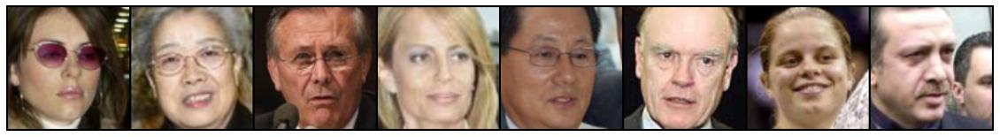

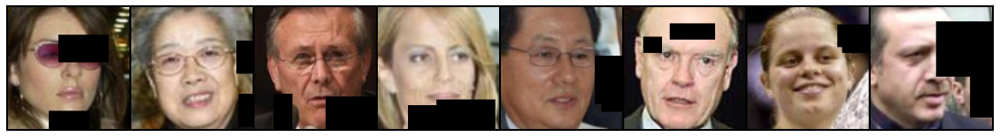

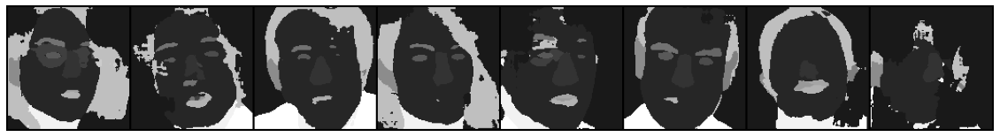

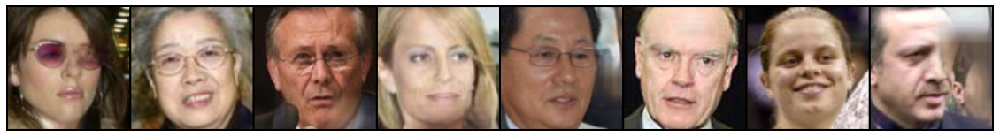

  0%|          | 0/750 [00:00<?, ?it/s]

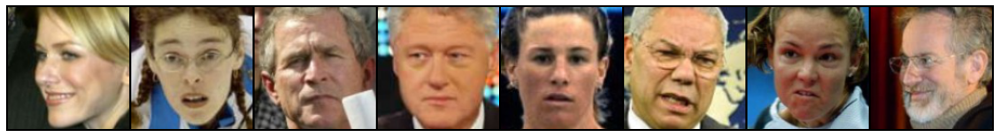

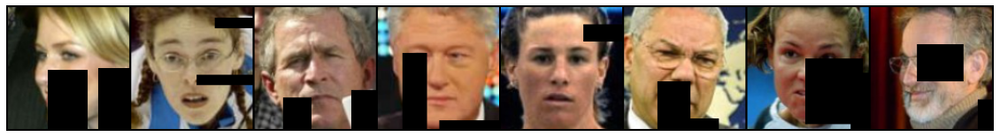

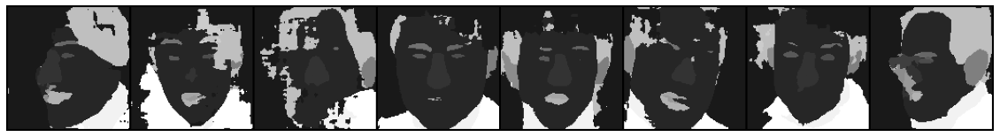

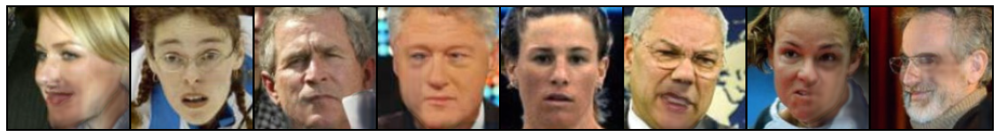

  0%|          | 0/750 [00:00<?, ?it/s]

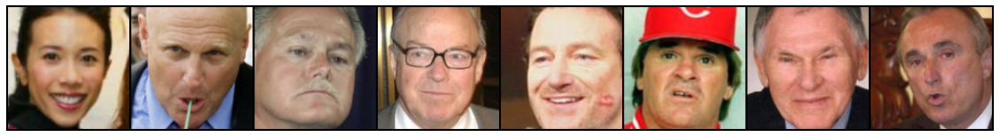

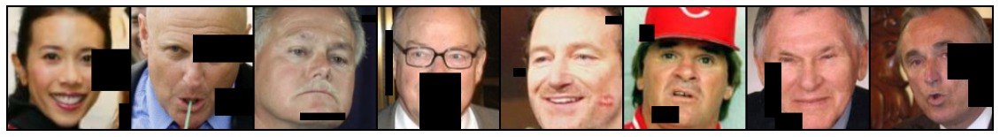

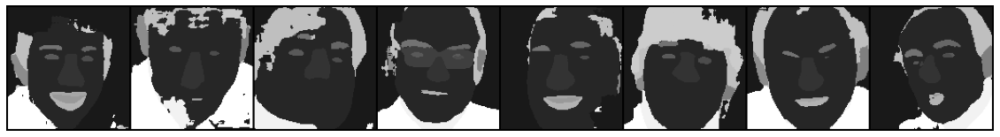

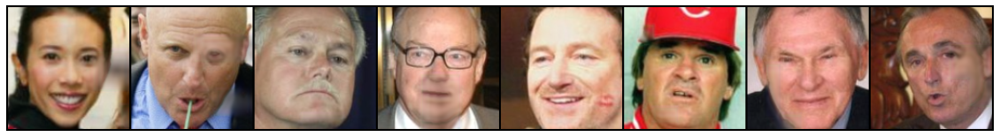

  0%|          | 0/750 [00:00<?, ?it/s]

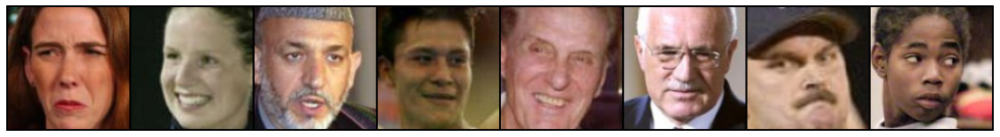

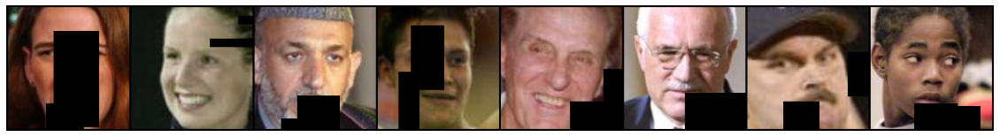

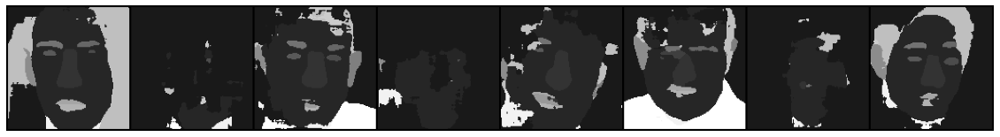

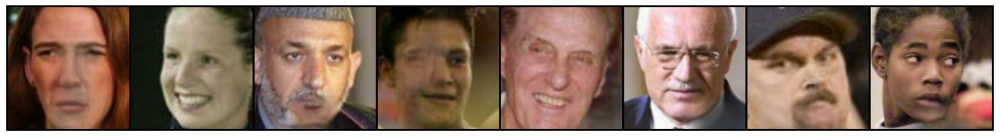

  0%|          | 0/750 [00:00<?, ?it/s]

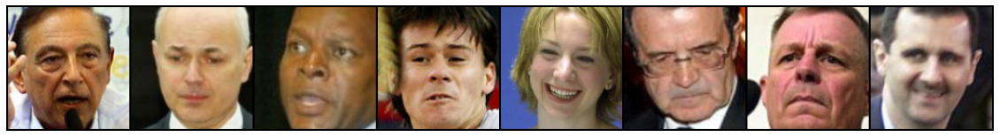

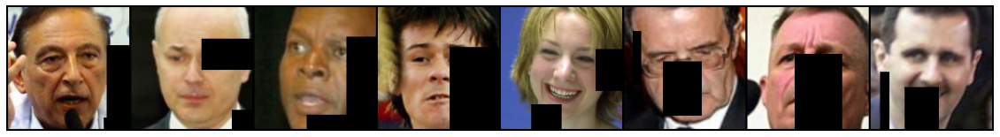

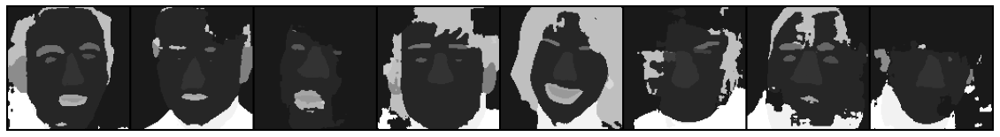

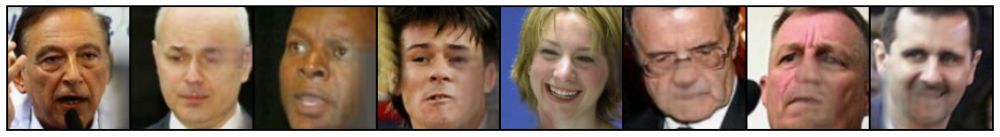

  0%|          | 0/750 [00:00<?, ?it/s]

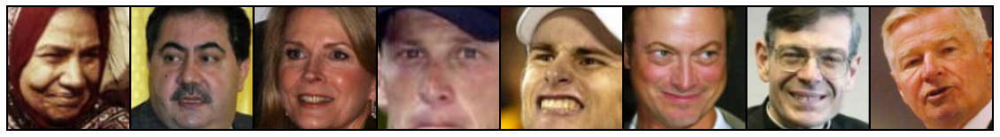

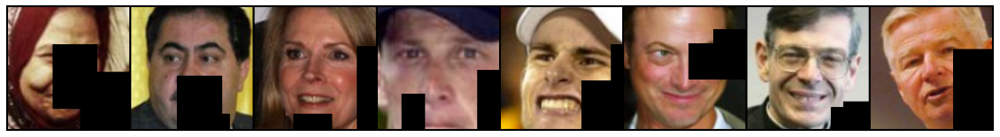

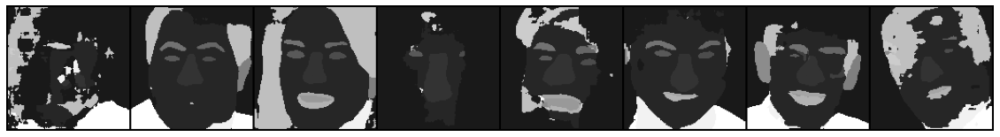

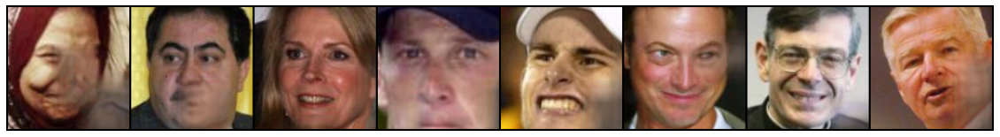

In [14]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=0.001)
train_inpainting_segmented(model, optimizer, trainloader, simplify_seg=True, epochs=10, min_cut=8, max_cut=120)

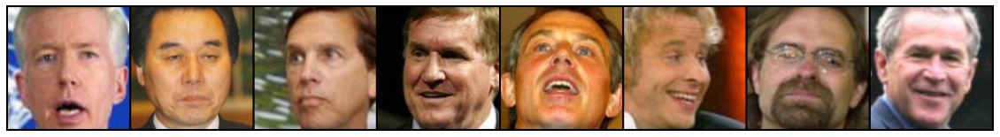

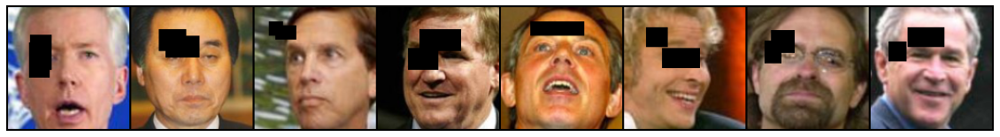

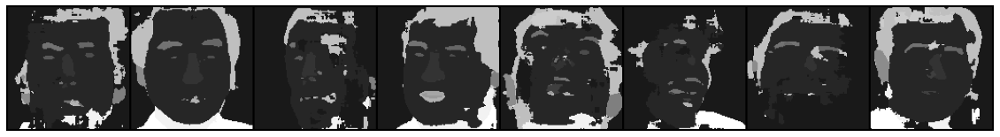

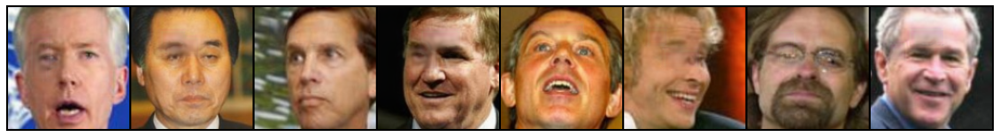

In [15]:
test_results_sample(model, testloader, simplify_seg=True, min_cut=15,max_cut=45)

### 128x128

In [ ]:
def get_faces_loader(path, **kwargs):
    process = transforms.Compose(
      [transforms.Resize((240, 240)), transforms.CenterCrop((128, 128)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    lengths = [12000, 1233]
    train_set, val_set = torch.utils.data.random_split(dataset, lengths)
    return DataLoader(train_set, **kwargs), DataLoader(val_set, **kwargs)

In [ ]:
trainloader, testloader = get_faces_loader(path='../test/data/lfw', 
                                    batch_size=8, 
                                    shuffle=True, 
                                    num_workers=0)

In [ ]:
def train_inpainting_segmented(net, optimizer, loader, epochs=5, min_cut=15,max_cut=45, simplify_seg=True, show_images=True):
    criterion = torch.nn.L1Loss()
    for epoch in range(epochs):
        running_loss = []
        t = tqdm(loader)
        for x, _ in t:
            x = x.to(device)
            segmented = get_segmentation(x, simplify=simplify_seg, scale_factor=2)
            x_co = random_cutout(x, min_cut, max_cut)
            x_input = torch.cat((x_co, segmented),dim=1)
            outputs = net(x_input)
            loss = criterion(outputs, x) + perceptual_loss(outputs, x)
            running_loss.append(loss.item())
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t.set_description(f'training loss: {mean(running_loss)}')
        if show_images:
            plot_img(x[:8])
            plot_img(x_co[:8])
            if simplify_seg:
                plot_img(segmented[:8])
            #else:
            #    classifDisplay = imp.loss.generate_label(segmented,w).to(device)
            #    plot_img(classifDisplay[:8])
            plot_img(torch.clip(outputs[:8], 0, 1))
            
def test_results_sample(net, testloader, simplify_seg=True, min_cut=15,max_cut=45, n=8):
    with torch.no_grad():
        x, _ = next(iter(testloader))
        x = x.to(device)
        
        segmented = get_segmentation(x, simplify=simplify_seg)
        
        x_co = random_cutout(x, min_cut, max_cut)
        x_input = torch.cat((x_co, segmented),dim=1)
        outputs = net(x_input)
        plot_img(x[:n])
        plot_img(x_co[:n])
        if simplify_seg:
            plot_img(segmented[:n])
        else:
            classifDisplay = imp.loss.generate_label(segmented,w).to(device)
            plot_img(classifDisplay[:n])
        plot_img(torch.clip(outputs[:n], 0, 1))

  0%|          | 0/750 [00:00<?, ?it/s]

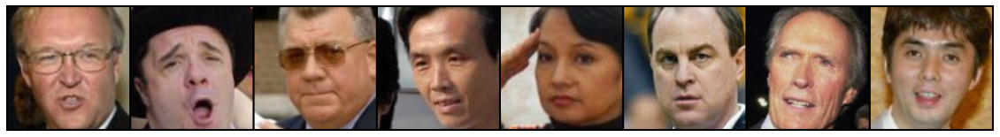

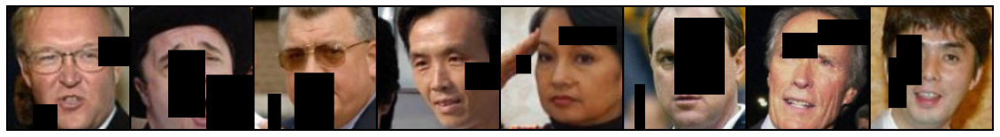

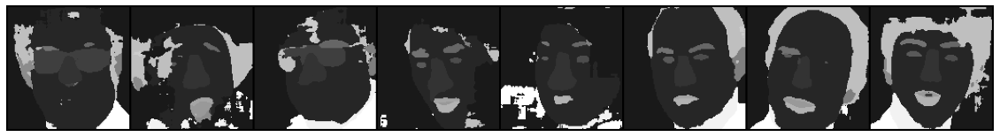

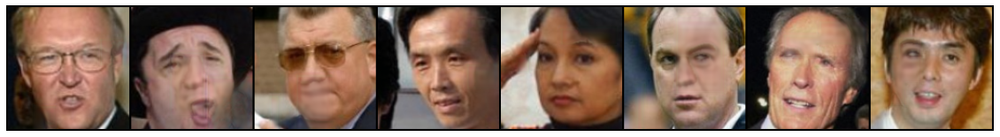

  0%|          | 0/750 [00:00<?, ?it/s]

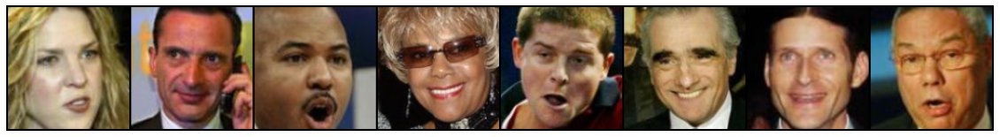

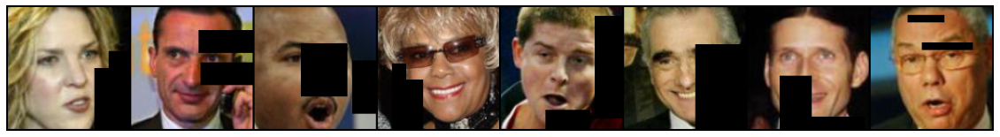

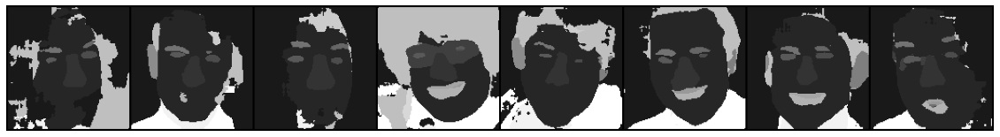

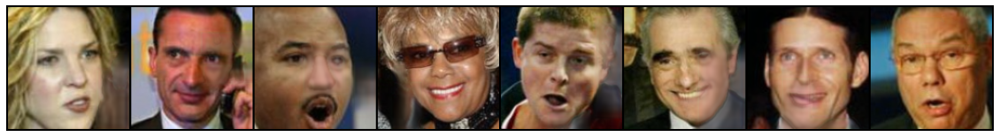

  0%|          | 0/750 [00:00<?, ?it/s]

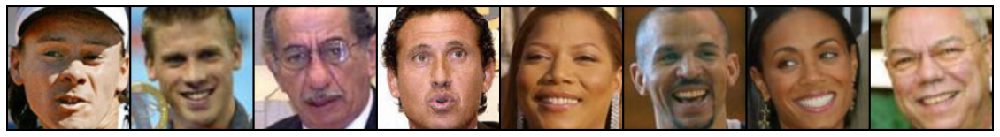

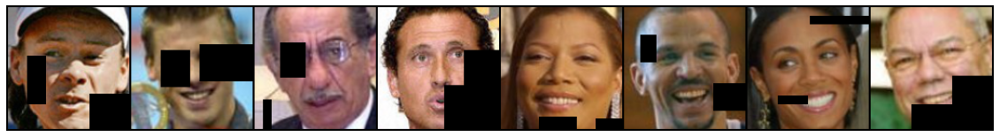

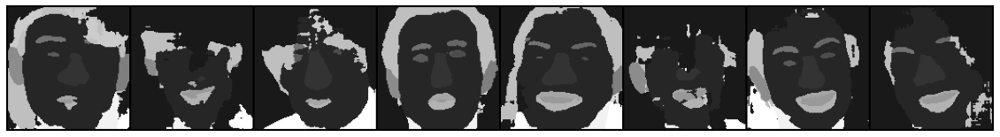

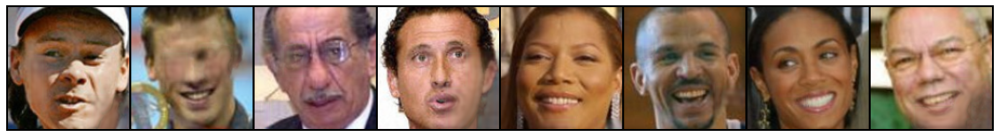

  0%|          | 0/750 [00:00<?, ?it/s]

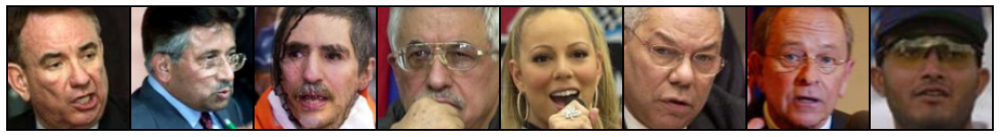

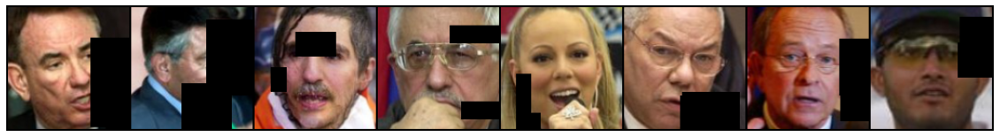

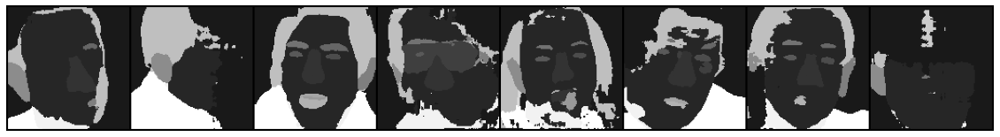

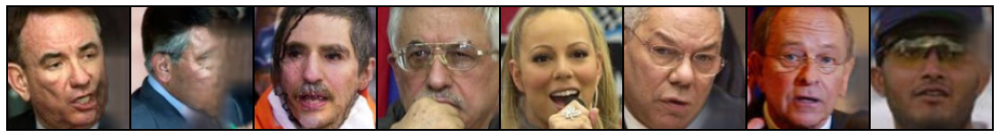

  0%|          | 0/750 [00:00<?, ?it/s]

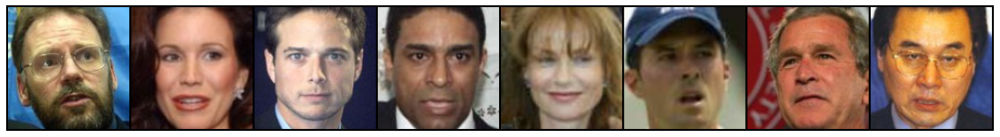

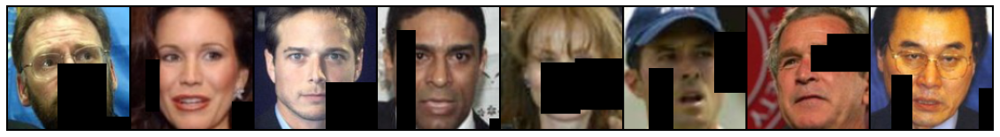

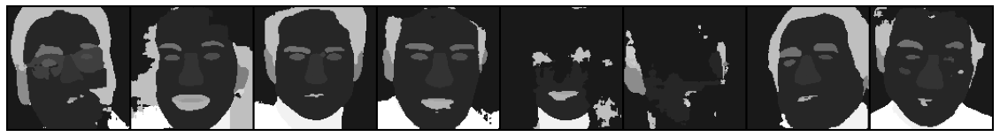

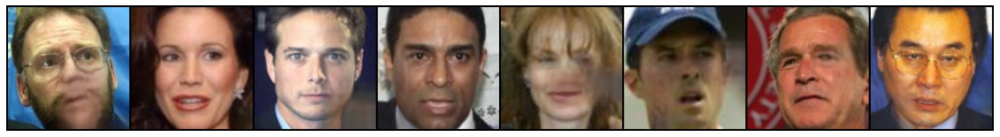

  0%|          | 0/750 [00:00<?, ?it/s]

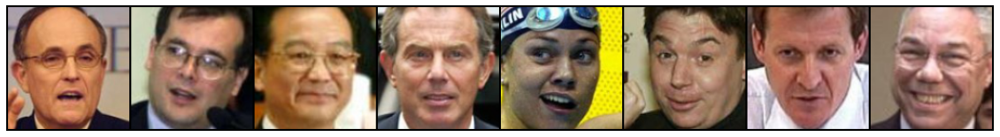

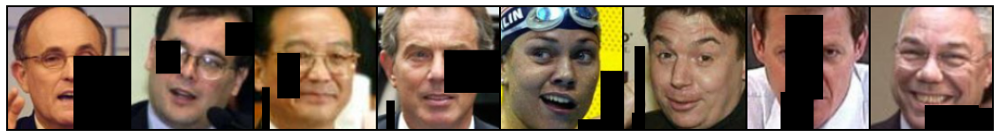

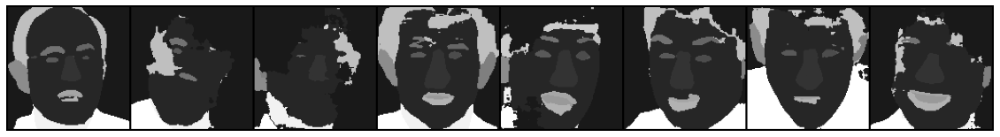

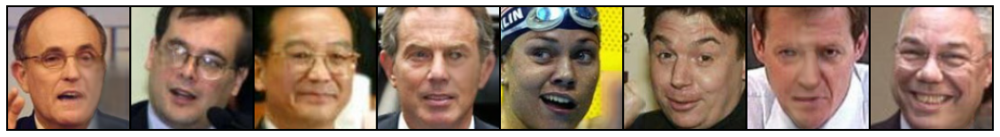

  0%|          | 0/750 [00:00<?, ?it/s]

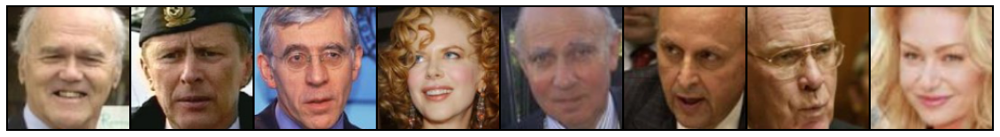

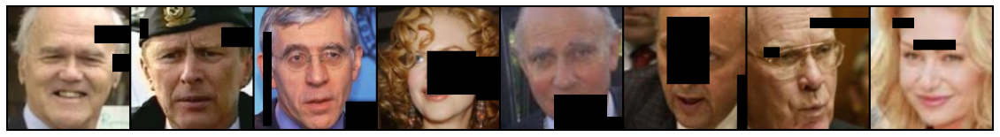

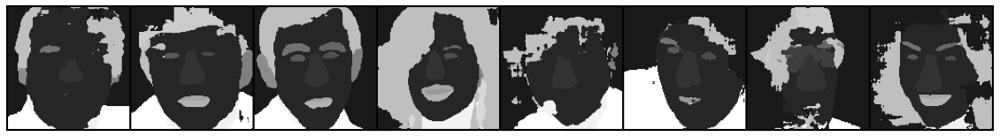

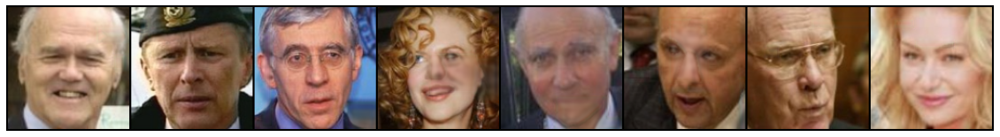

  0%|          | 0/750 [00:00<?, ?it/s]

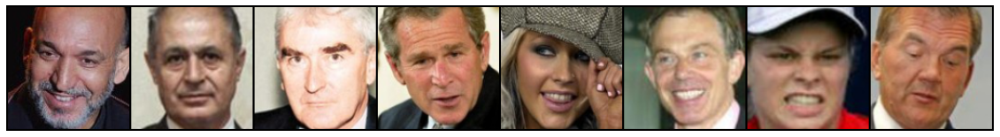

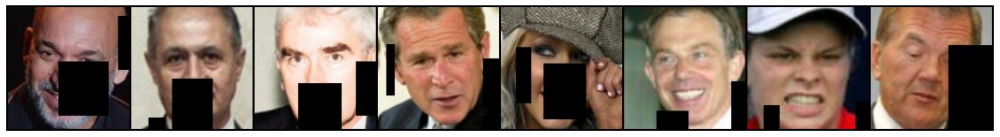

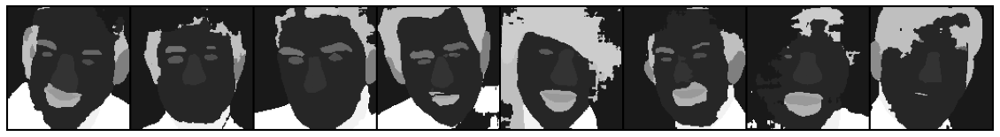

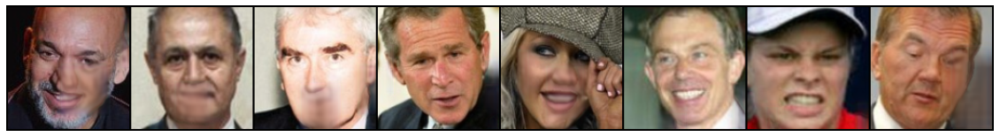

  0%|          | 0/750 [00:00<?, ?it/s]

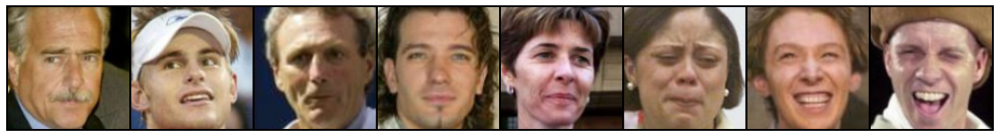

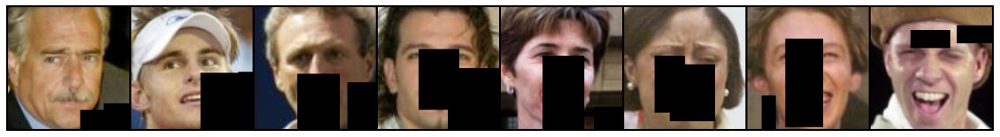

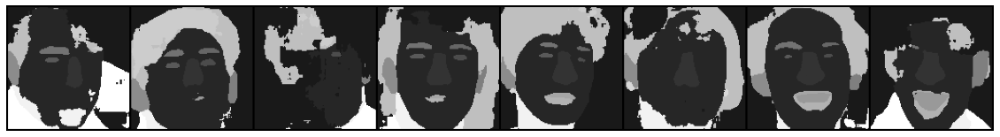

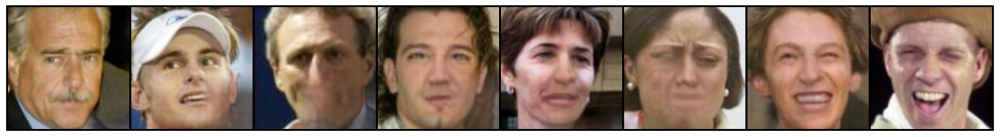

  0%|          | 0/750 [00:00<?, ?it/s]

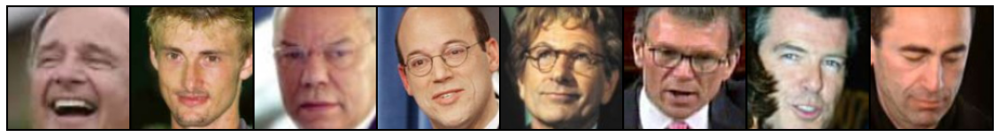

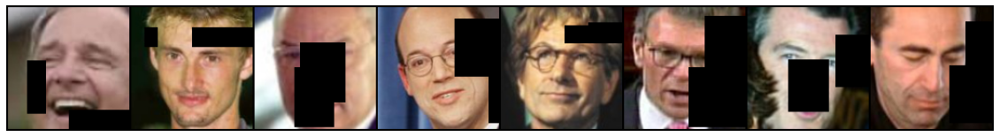

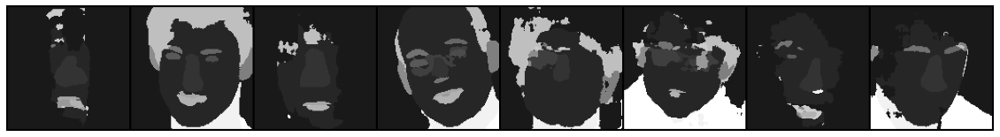

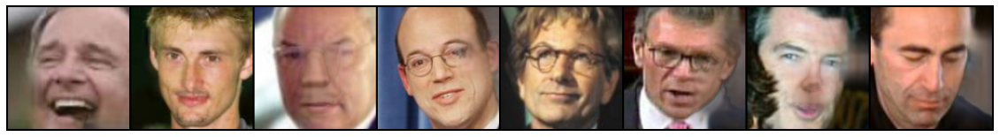

In [47]:
optimizer = torch.optim.Adam(model.parameters(), lr=5e-5, weight_decay=0.001)
train_inpainting_segmented(model, optimizer, trainloader, simplify_seg=True, epochs=10, min_cut=8, max_cut=120)

### 256x256

In [12]:
def get_faces_loader(path, **kwargs):
    process = transforms.Compose(
      [transforms.Resize((480, 480)), transforms.CenterCrop((256, 256)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    lengths = [len(dataset)-1200, 1200]
    train_set, val_set = torch.utils.data.random_split(dataset, lengths)
    return DataLoader(train_set, **kwargs), DataLoader(val_set, **kwargs)

In [14]:
trainloader, testloader = get_faces_loader(path='./data/lfw', 
                                    batch_size=8, 
                                    shuffle=True, 
                                    num_workers=0)

In [15]:
def train_inpainting_segmented(net, optimizer, loader, epochs=5, min_cut=15,max_cut=45, simplify_seg=True, show_images=True):
    criterion = torch.nn.L1Loss()
    for epoch in range(epochs):
        running_loss = []
        t = tqdm(loader)
        for x, _ in t:
            x = x.to(device)
            segmented = get_segmentation(x, simplify=simplify_seg, scale_factor=2)
            x_co = random_cutout(x, min_cut, max_cut)
            x_input = torch.cat((x_co, segmented),dim=1)
            outputs = net(x_input)
            loss = criterion(outputs, x) + perceptual_loss(outputs, x)
            running_loss.append(loss.item())
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t.set_description(f'training loss: {mean(running_loss)}')
        if show_images:
            plot_img(x[:8])
            plot_img(x_co[:8])
            if simplify_seg:
                plot_img(segmented[:8])
            #else:
            #    classifDisplay = imp.loss.generate_label(segmented,w).to(device)
            #    plot_img(classifDisplay[:8])
            plot_img(torch.clip(outputs[:8], 0, 1))
            
def test_results_sample(net, testloader, simplify_seg=True, min_cut=15,max_cut=45, n=8):
    with torch.no_grad():
        x, _ = next(iter(testloader))
        x = x.to(device)
        
        segmented = get_segmentation(x, simplify=simplify_seg)
        
        x_co = random_cutout(x, min_cut, max_cut)
        x_input = torch.cat((x_co, segmented),dim=1)
        outputs = net(x_input)
        plot_img(x[:n])
        plot_img(x_co[:n])
        if simplify_seg:
            plot_img(segmented[:n])
        else:
            classifDisplay = imp.loss.generate_label(segmented,w).to(device)
            plot_img(classifDisplay[:n])
        plot_img(torch.clip(outputs[:n], 0, 1))

In [16]:
optimizer = torch.optim.Adam(model.parameters(), lr=5e-5, weight_decay=0.001)
train_inpainting_segmented(model, optimizer, trainloader, simplify_seg=True, epochs=10, min_cut=16, max_cut=240)

NameError: name 'model' is not defined

### CelebA

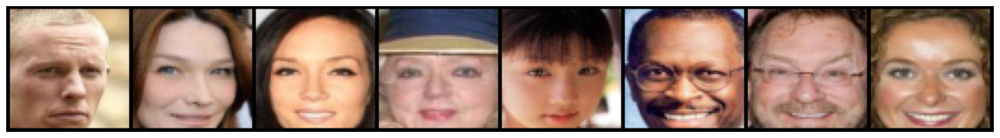

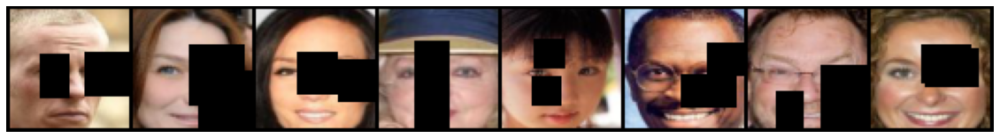

In [52]:
def get_celebA_loader(path, **kwargs):
    process = transforms.Compose(
     # [transforms.Resize((480, 480)), transforms.CenterCrop((256, 256)),transforms.ToTensor()])
        [transforms.Resize((120, 120)), transforms.CenterCrop((64, 64)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    lengths = [201000, 1599]
    train_set, val_set = torch.utils.data.random_split(dataset, lengths)
    return DataLoader(train_set, **kwargs), DataLoader(val_set, **kwargs)

celebA_trainloader, celebA_testloader = get_celebA_loader(path='celebA', 
                                    batch_size=8, 
                                    shuffle=True, 
                                    num_workers=0)
x, _ = next(iter(celebA_trainloader))
x_co = random_cutout(x)
plot_img(x[:8])
plot_img(x_co[:8])
n,c,w,h = x.shape

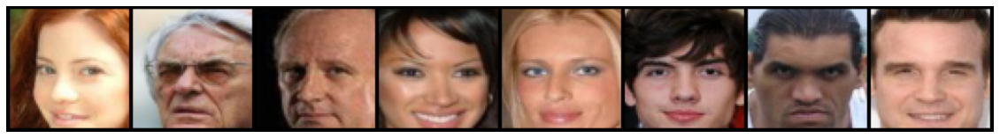

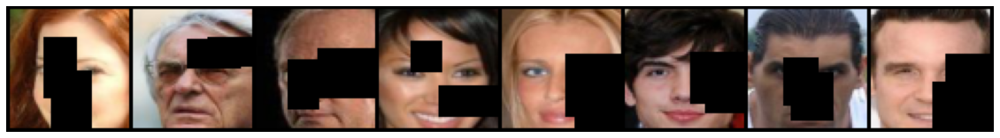

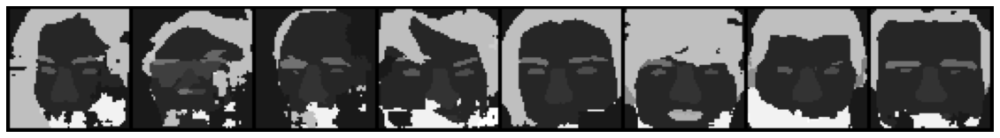

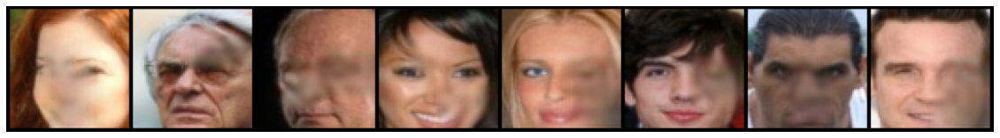

In [53]:
test_results_sample(model, celebA_testloader, simplify_seg=True, min_cut=15,max_cut=45)

#### Fine tunning

In [54]:
def get_faces_loader(path, **kwargs):
    process = transforms.Compose(
      [transforms.Resize((480, 480)), transforms.CenterCrop((256, 256)),transforms.ToTensor()])
        #[transforms.Resize((120, 120)), transforms.CenterCrop((64, 64)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    lengths = [201000, 1599]
    train_set, val_set = torch.utils.data.random_split(dataset, lengths)
    return DataLoader(train_set, **kwargs), DataLoader(val_set, **kwargs)



def get_segmentation(x, segmenter=classif, scale_factor=4, simplify=True):
    with torch.no_grad():
        x = transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))(x)
        y = classif(x)
    if simplify: return simplify_segmentation(y)
    else: return y

def train_inpainting_segmented(net, optimizer, loader, epochs=5, min_cut=15,max_cut=45, simplify_seg=True, show_images=True):
    criterion = torch.nn.L1Loss()
    for epoch in range(epochs):
        running_loss = []
        t = tqdm(loader)
        for x, _ in t:
            x = x.to(device)
            segmented = get_segmentation(x, simplify=simplify_seg, scale_factor=2)
            x_co = random_cutout(x, min_cut, max_cut)
            x_input = torch.cat((x_co, segmented),dim=1)
            outputs = net(x_input)
            loss = criterion(outputs, x) + perceptual_loss(outputs, x)
            running_loss.append(loss.item())
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t.set_description(f'training loss: {mean(running_loss)}')
        if show_images:
            plot_img(x[:8])
            plot_img(x_co[:8])
            if simplify_seg:
                plot_img(segmented[:8])
            #else:
            #    classifDisplay = imp.loss.generate_label(segmented,w).to(device)
            #    plot_img(classifDisplay[:8])
            plot_img(torch.clip(outputs[:8], 0, 1))

  0%|          | 0/25125 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The Jupyter serve

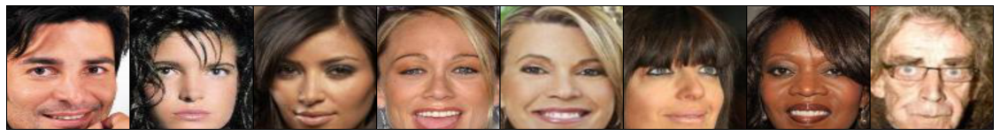

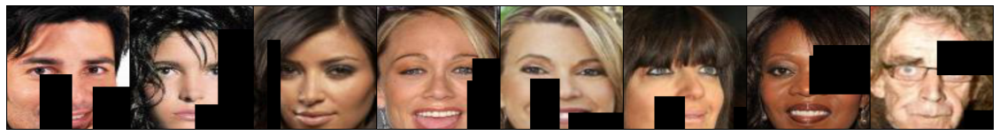

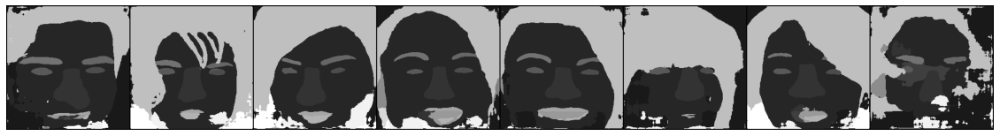

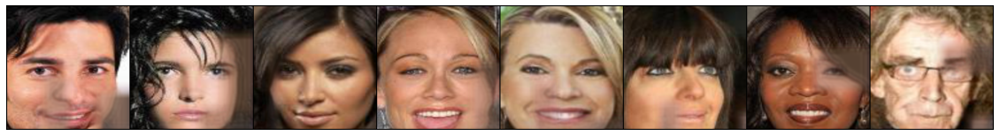

  0%|          | 0/25125 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



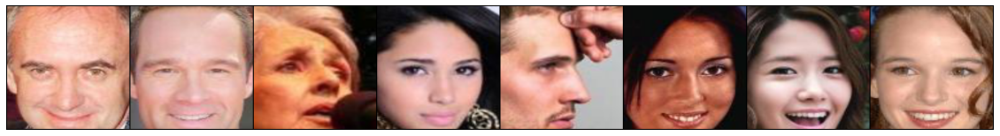

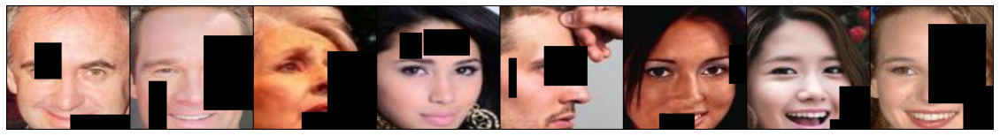

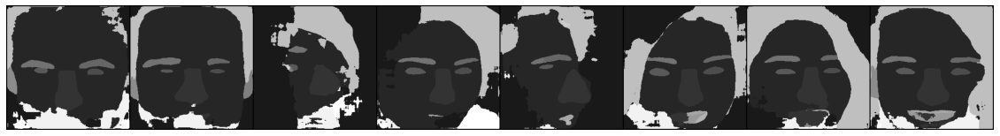

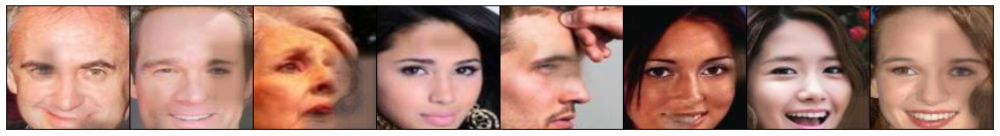

In [61]:
celebA_trainloader, celebA_testloader = get_faces_loader(path='celebA', 
                                    batch_size=8, 
                                    shuffle=True, 
                                    num_workers=0)

optimizer = torch.optim.Adam(model.parameters(), lr=5e-5, weight_decay=0.001)
train_inpainting_segmented(model, optimizer, celebA_trainloader, simplify_seg=True, epochs=3, min_cut=16, max_cut=240)

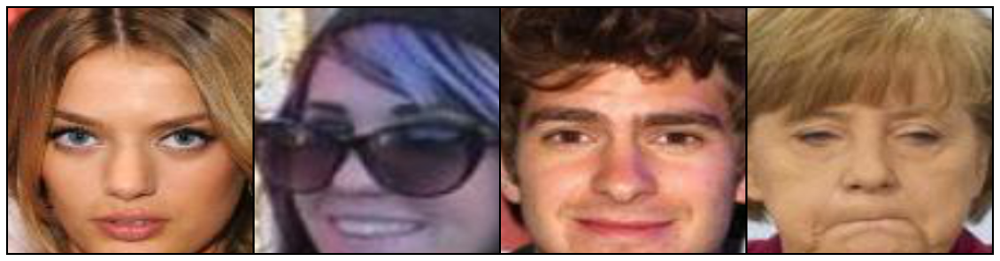

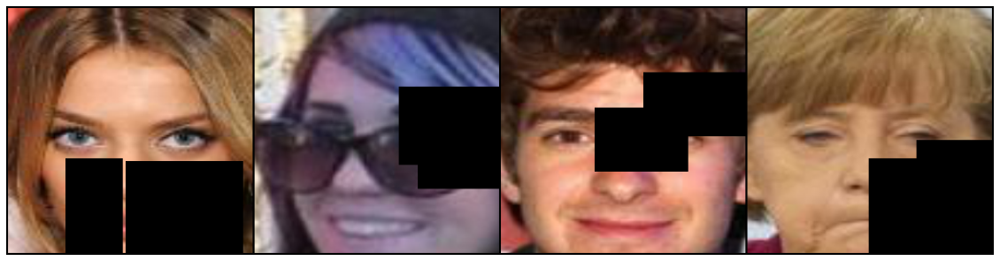

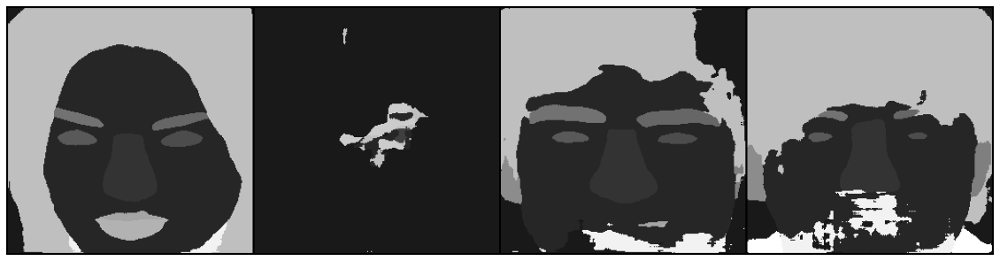

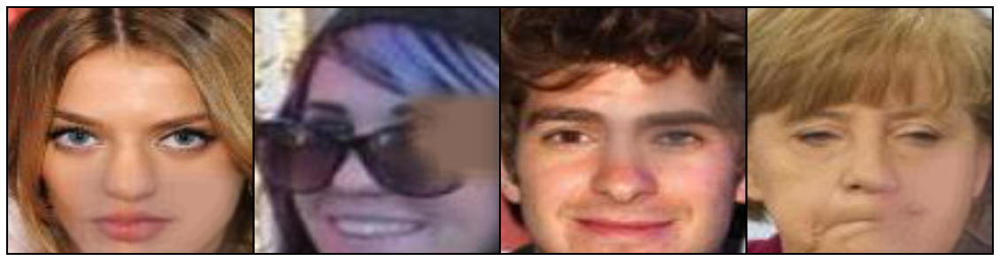

In [65]:
test_results_sample(model, celebA_testloader, simplify_seg=True, min_cut=60,max_cut=180, n=4)

### Other images

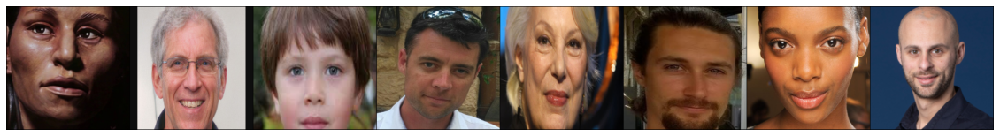

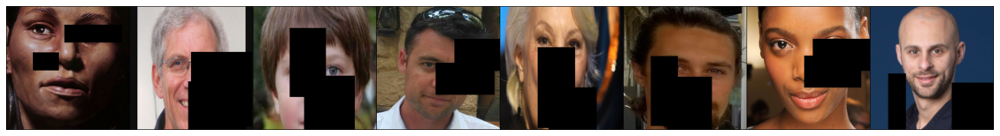

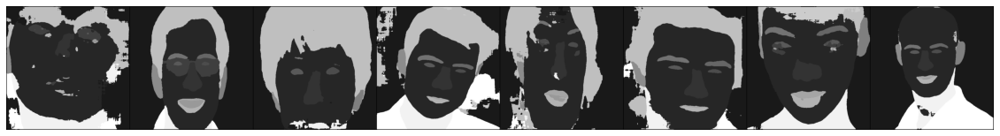

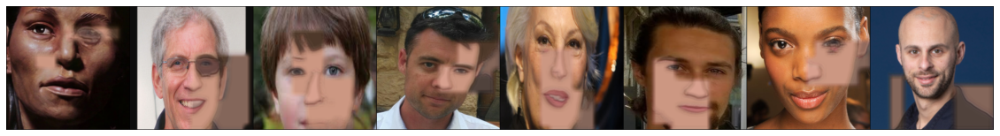

In [67]:
def get_test_faces_loader(path, **kwargs):
    process = transforms.Compose(
     [transforms.Resize((600, 600)), transforms.CenterCrop((512, 512)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    return DataLoader(dataset, **kwargs)

testloader2 = get_test_faces_loader(path='TestSet/', 
                                    batch_size=8, 
                                    shuffle=False, 
                                    num_workers=0)
x, _ = next(iter(testloader2))
n,c,w,h = x.shape

test_results_sample(model, testloader2, simplify_seg=True, min_cut=60,max_cut=360)

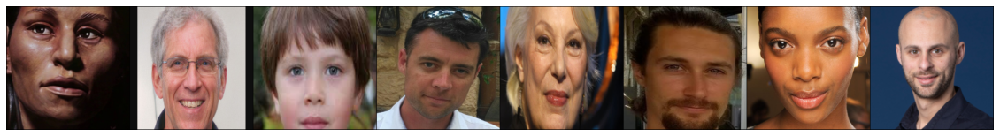

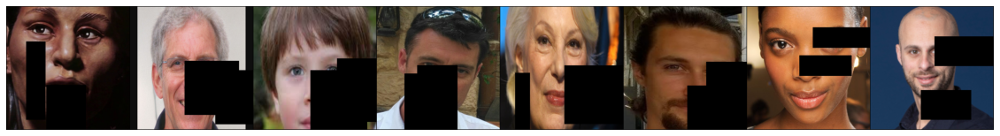

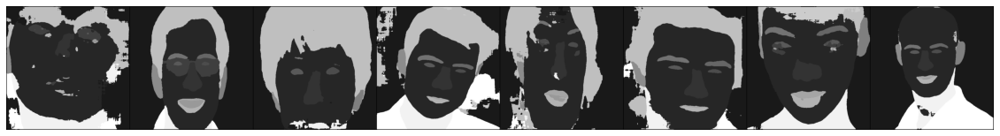

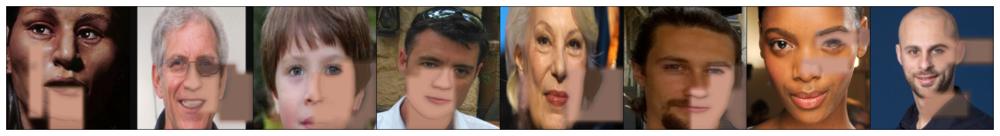

In [68]:
test_results_sample(model, testloader2, simplify_seg=True, min_cut=60,max_cut=360)

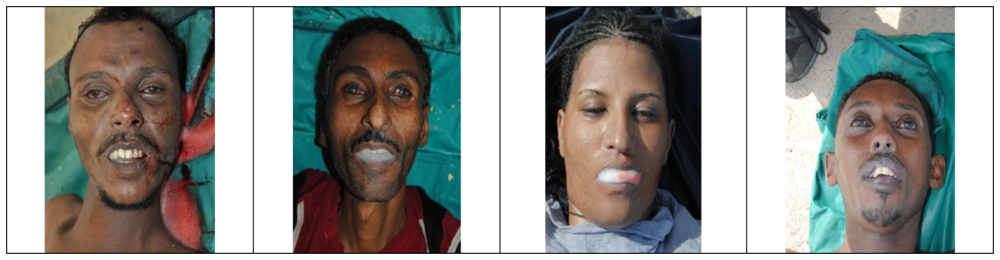

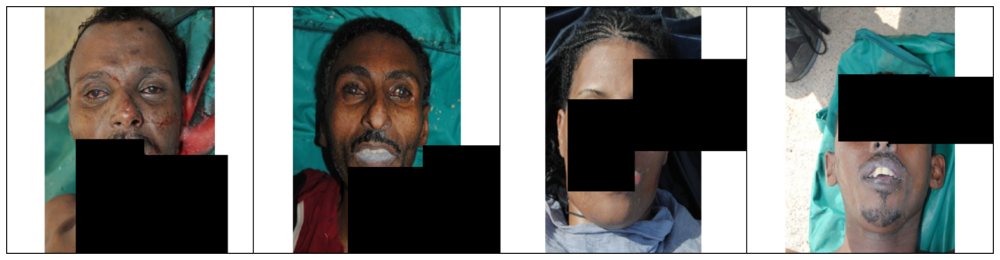

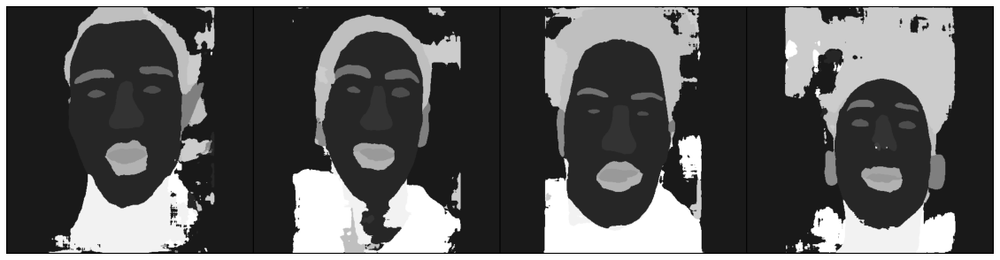

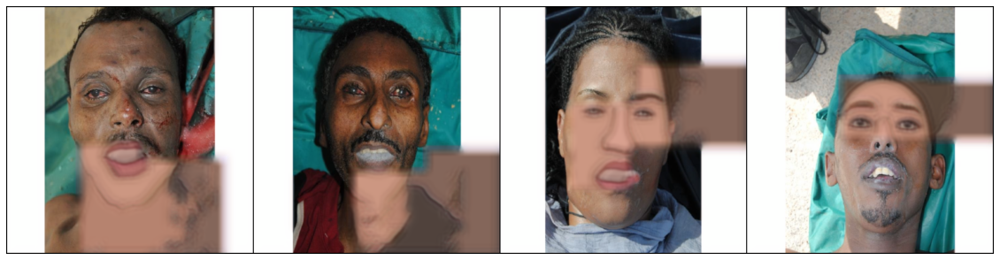

In [69]:
def get_test_faces_loader(path, **kwargs):
    process = transforms.Compose(
     [transforms.Resize((600, 600)), transforms.CenterCrop((512, 512)),transforms.ToTensor()])
    dataset = ImageFolder(path, process)
    return DataLoader(dataset, **kwargs)

testloader2 = get_test_faces_loader(path='cadavres/', 
                                    batch_size=8, 
                                    shuffle=True, 
                                    num_workers=0)
x, _ = next(iter(testloader2))
n,c,w,h = x.shape

test_results_sample(model, testloader2, simplify_seg=True, min_cut=60,max_cut=360, n=4)

In [70]:
torch.save(model.state_dict(), 'unet_inpainting.pth')